Выгружаем данные из циана, изначально я выгружал почти с теми же параметры которые есть в документации, только поменял город на Питер и удалил ограничение по страницам, потом больше не смог выгружать из за captcha

In [71]:
import cianparser
    
data = cianparser.parse(
    deal_type="rent_long",
    accommodation_type="flat",
    location="Санкт-Петербург",
    is_saving_csv=True,
)

print(data[0])


                              Preparing to collect information from pages..
The absolute path to the file: 
c:\Users\andvi\OneDrive\Desktop\data science\cian_parsing_result_rent_long_1_100_sankt-peterburg_07_Dec_2023_22_01_55_141144.csv 

The page from which the collection of information begins: 
 https://cian.ru/cat.php?engine_version=2&p=1&region=2&offer_type=flat&deal_type=rent&with_neighbors=0&type=4
 1 | 1 page with list: [=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>] 100% | Count of all parsed: 28. Progress ratio: 1 %. Average price: 52 638 rub
 2 | 2 page with list: [=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>] 100% | Count of all parsed: 56. Progress ratio: 2 %. Average price: 76 892 rub
 3 | 3 page with list: [=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>] 100% | Count of all parsed: 84. Progress ratio: 3 %. Average price: 82 058 rub
 4 | 4 page with list: [=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>=>] 100% | Count of all parsed

# ОБЪЕДИНЕНИЕ ДАТАСЕТОВ

Объединяем данные из csv в parquet

In [1]:
import numpy as np
import pandas as pd
import pyarrow as pa

df = None

for i in range(0,23):
    filename = f'data_rent_long_{i}.csv'
    temp = None
    try:
        temp = pd.read_csv(filename, sep=';')
    except:
        temp = pd.read_csv(filename, sep=';', encoding='cp1251')
    df = pd.concat([df, temp], ignore_index=True)
    
for i in range(0,26):
    filename = f'data_sale_{i}.csv'
    temp = None
    try:
        temp = pd.read_csv(filename, sep=';')
    except:
        temp = pd.read_csv(filename, sep=';', encoding='cp1251')
    df = pd.concat([df, temp], ignore_index=True)

#df1 = pd.read_csv('data.csv', sep=';')
df

,author,author_type,link,city,deal_type,accommodation_type,floor,floors_count,rooms_count,total_meters,price_per_m2,price_per_month,commissions,district,street,house_number,underground,price,residential_complex
0,Циан х ПИК-Аренда СПб,real_estate_agent,https://spb.cian.ru/rent/flat/294789239/,Санкт-Петербург,rent,flat,7,12,1,32.00,1087,34800.0,0.0,Приморский,Планерная,87к1,Комендантский проспект,NaN,NaN
1,Циан х ПИК-Аренда СПб,real_estate_agent,https://spb.cian.ru/rent/flat/295416885/,Санкт-Петербург,rent,flat,5,9,2,50.50,1041,52600.0,0.0,Фрунзенский,Будапештская,98К3,Дунайская,NaN,NaN
2,Екатерина Орлова,realtor,https://spb.cian.ru/rent/flat/291326258/,Санкт-Петербург,rent,flat,3,5,-1,18.00,1000,18000.0,0.0,Центральный,Чехова,1/12,Маяковская,NaN,NaN
3,VALO Hotel City,real_estate_agent,https://spb.cian.ru/rent/flat/289246978/,Санкт-Петербург,rent,flat,11,18,-1,16.00,2062,33000.0,0.0,Фрунзенский,Салова,61,Бухарестская,NaN,NaN
4,Стандарт Девелопмент,real_estate_agent,https://spb.cian.ru/rent/flat/293135769/,Санкт-Петербург,rent,flat,11,19,2,76.00,894,68000.0,0.0,Московский,Киевская,3,Фрунзенская,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28236,GloraX,developer,https://spb.cian.ru/sale/flat/279508047/,Санкт-Петербург,sale,flat,2,19,3,84.27,275424,NaN,NaN,Василеостровский,Морской,NaN,Зенит,23209999.0,Глоракс Премиум Василеостровский ЖК
28237,RBI,developer,https://spb.cian.ru/sale/flat/295748649/,Санкт-Петербург,sale,flat,3,23,3,89.60,258698,NaN,NaN,Выборгский,Шувалово-Озерки,NaN,Проспект Просвещения,23179404.0,Струны
28238,Строительный трест,developer,https://spb.cian.ru/sale/flat/274590050/,Санкт-Петербург,sale,flat,3,13,3,104.10,222507,NaN,NaN,Выборгский,Лиственная,20к2,Озерки,23163000.0,Листва
28239,HANSA GROUP,developer,https://spb.cian.ru/sale/flat/294019527/,Санкт-Петербург,sale,flat,4,6,3,86.50,266000,NaN,NaN,Выборгский,Зеленогорская,3,Удельная,23009000.0,Дом Аура у Светлановской


In [2]:
import pyarrow.parquet as pq

table = pa.Table.from_pandas(df)
pq.write_table(table, 'cian.parquet')

# Импорт данных

In [3]:
data = pq.read_table('cian.parquet').to_pandas()
data

,author,author_type,link,city,deal_type,accommodation_type,floor,floors_count,rooms_count,total_meters,price_per_m2,price_per_month,commissions,district,street,house_number,underground,price,residential_complex
0,Циан х ПИК-Аренда СПб,real_estate_agent,https://spb.cian.ru/rent/flat/294789239/,Санкт-Петербург,rent,flat,7,12,1,32.00,1087,34800.0,0.0,Приморский,Планерная,87к1,Комендантский проспект,NaN,None
1,Циан х ПИК-Аренда СПб,real_estate_agent,https://spb.cian.ru/rent/flat/295416885/,Санкт-Петербург,rent,flat,5,9,2,50.50,1041,52600.0,0.0,Фрунзенский,Будапештская,98К3,Дунайская,NaN,None
2,Екатерина Орлова,realtor,https://spb.cian.ru/rent/flat/291326258/,Санкт-Петербург,rent,flat,3,5,-1,18.00,1000,18000.0,0.0,Центральный,Чехова,1/12,Маяковская,NaN,None
3,VALO Hotel City,real_estate_agent,https://spb.cian.ru/rent/flat/289246978/,Санкт-Петербург,rent,flat,11,18,-1,16.00,2062,33000.0,0.0,Фрунзенский,Салова,61,Бухарестская,NaN,None
4,Стандарт Девелопмент,real_estate_agent,https://spb.cian.ru/rent/flat/293135769/,Санкт-Петербург,rent,flat,11,19,2,76.00,894,68000.0,0.0,Московский,Киевская,3,Фрунзенская,NaN,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28236,GloraX,developer,https://spb.cian.ru/sale/flat/279508047/,Санкт-Петербург,sale,flat,2,19,3,84.27,275424,NaN,NaN,Василеостровский,Морской,None,Зенит,23209999.0,Глоракс Премиум Василеостровский ЖК
28237,RBI,developer,https://spb.cian.ru/sale/flat/295748649/,Санкт-Петербург,sale,flat,3,23,3,89.60,258698,NaN,NaN,Выборгский,Шувалово-Озерки,None,Проспект Просвещения,23179404.0,Струны
28238,Строительный трест,developer,https://spb.cian.ru/sale/flat/274590050/,Санкт-Петербург,sale,flat,3,13,3,104.10,222507,NaN,NaN,Выборгский,Лиственная,20к2,Озерки,23163000.0,Листва
28239,HANSA GROUP,developer,https://spb.cian.ru/sale/flat/294019527/,Санкт-Петербург,sale,flat,4,6,3,86.50,266000,NaN,NaN,Выборгский,Зеленогорская,3,Удельная,23009000.0,Дом Аура у Светлановской


# Чистка данных

### Удаление дублей

In [4]:
data.duplicated(keep='first').sum()

1719

In [5]:
data.drop_duplicates(keep='first')

,author,author_type,link,city,deal_type,accommodation_type,floor,floors_count,rooms_count,total_meters,price_per_m2,price_per_month,commissions,district,street,house_number,underground,price,residential_complex
0,Циан х ПИК-Аренда СПб,real_estate_agent,https://spb.cian.ru/rent/flat/294789239/,Санкт-Петербург,rent,flat,7,12,1,32.00,1087,34800.0,0.0,Приморский,Планерная,87к1,Комендантский проспект,NaN,None
1,Циан х ПИК-Аренда СПб,real_estate_agent,https://spb.cian.ru/rent/flat/295416885/,Санкт-Петербург,rent,flat,5,9,2,50.50,1041,52600.0,0.0,Фрунзенский,Будапештская,98К3,Дунайская,NaN,None
2,Екатерина Орлова,realtor,https://spb.cian.ru/rent/flat/291326258/,Санкт-Петербург,rent,flat,3,5,-1,18.00,1000,18000.0,0.0,Центральный,Чехова,1/12,Маяковская,NaN,None
3,VALO Hotel City,real_estate_agent,https://spb.cian.ru/rent/flat/289246978/,Санкт-Петербург,rent,flat,11,18,-1,16.00,2062,33000.0,0.0,Фрунзенский,Салова,61,Бухарестская,NaN,None
4,Стандарт Девелопмент,real_estate_agent,https://spb.cian.ru/rent/flat/293135769/,Санкт-Петербург,rent,flat,11,19,2,76.00,894,68000.0,0.0,Московский,Киевская,3,Фрунзенская,NaN,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28236,GloraX,developer,https://spb.cian.ru/sale/flat/279508047/,Санкт-Петербург,sale,flat,2,19,3,84.27,275424,NaN,NaN,Василеостровский,Морской,None,Зенит,23209999.0,Глоракс Премиум Василеостровский ЖК
28237,RBI,developer,https://spb.cian.ru/sale/flat/295748649/,Санкт-Петербург,sale,flat,3,23,3,89.60,258698,NaN,NaN,Выборгский,Шувалово-Озерки,None,Проспект Просвещения,23179404.0,Струны
28238,Строительный трест,developer,https://spb.cian.ru/sale/flat/274590050/,Санкт-Петербург,sale,flat,3,13,3,104.10,222507,NaN,NaN,Выборгский,Лиственная,20к2,Озерки,23163000.0,Листва
28239,HANSA GROUP,developer,https://spb.cian.ru/sale/flat/294019527/,Санкт-Петербург,sale,flat,4,6,3,86.50,266000,NaN,NaN,Выборгский,Зеленогорская,3,Удельная,23009000.0,Дом Аура у Светлановской


### Удаление строк с пустыми значениями в релевантных столбцов

In [6]:
data.isnull().sum()

author                   481
author_type              481
link                       0
city                       0
deal_type                  0
accommodation_type         0
floor                      0
floors_count               0
rooms_count                0
total_meters               0
price_per_m2               0
price_per_month        16684
commissions            16684
district                1298
street                  2882
house_number            4248
underground             9584
price                  11557
residential_complex    17428
dtype: int64

In [7]:
data.dropna(subset=['district','street','house_number','author','author_type'], axis=0, how='any', inplace = True)
data.isnull().sum()

author                     0
author_type                0
link                       0
city                       0
deal_type                  0
accommodation_type         0
floor                      0
floors_count               0
rooms_count                0
total_meters               0
price_per_m2               0
price_per_month        11865
commissions            11865
district                   0
street                     0
house_number               0
underground             8253
price                  11180
residential_complex    16946
dtype: int64

### Удаление строк с неправильными значениями

In [8]:
columns = ["price_per_month","total_meters","price_per_m2","rooms_count","price"]

data = data[data[columns].min(axis=1) > 0]

### Обработка оутлаеров

In [9]:
cities = data['city'].unique()
print(cities)

['Санкт-Петербург' 'Казань' 'Краснодар' 'Москва' 'Новосибирск' 'Челябинск'
 'Екатеринбург']


In [10]:
deal_types = data['deal_type'].unique()
print(deal_types)

['rent' 'sale']


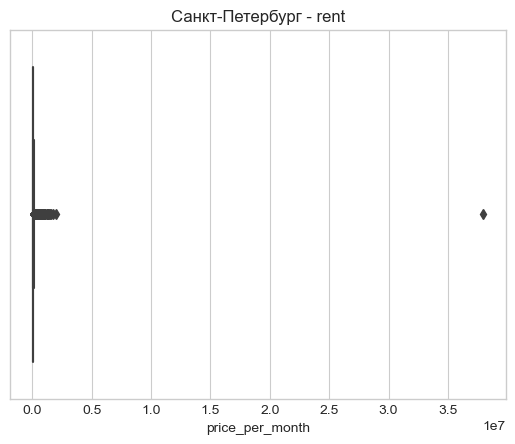

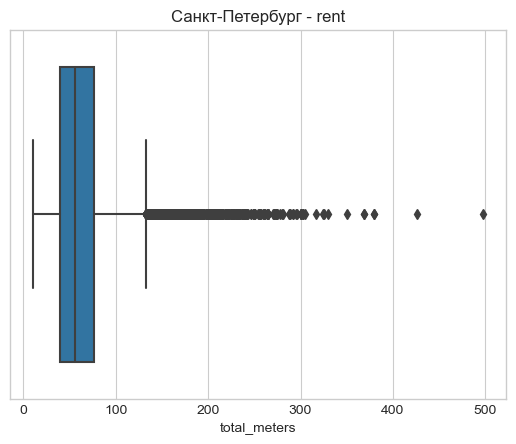

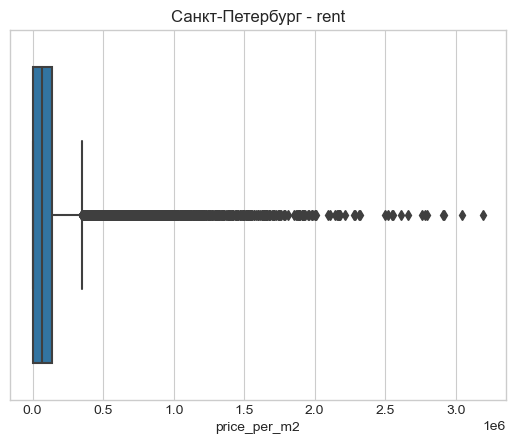

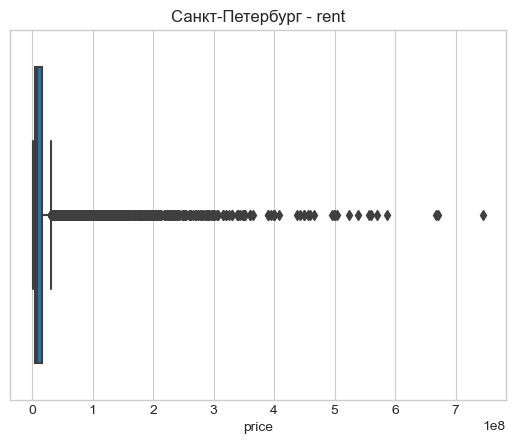

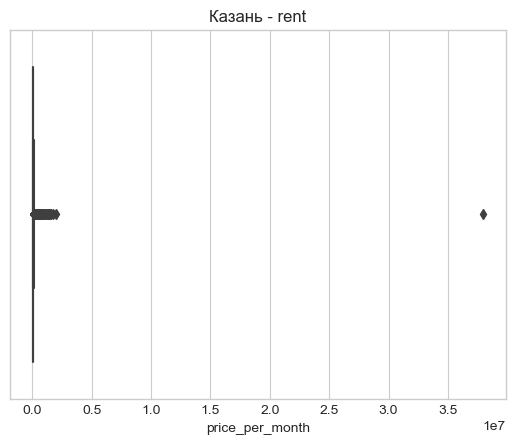

...

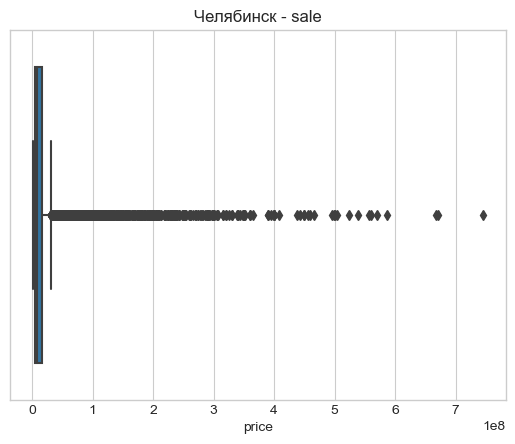

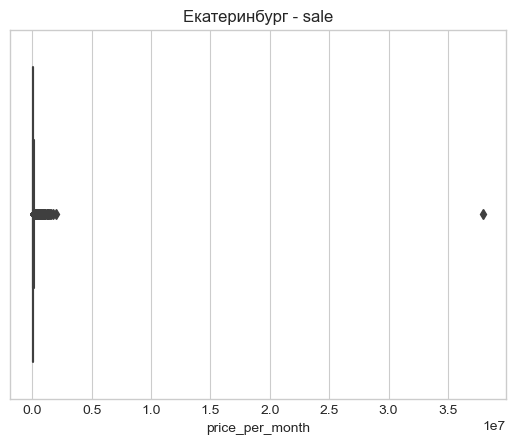

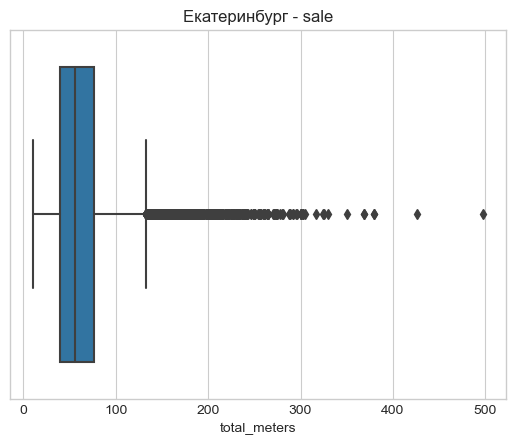

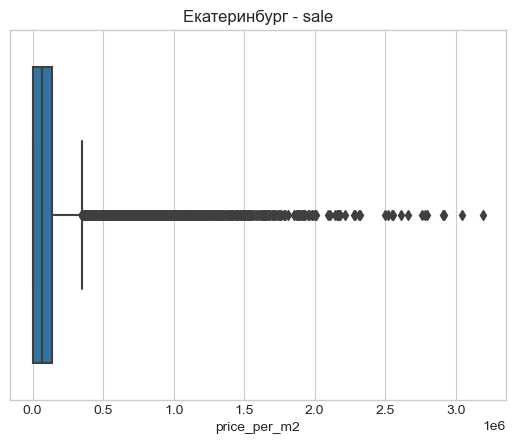

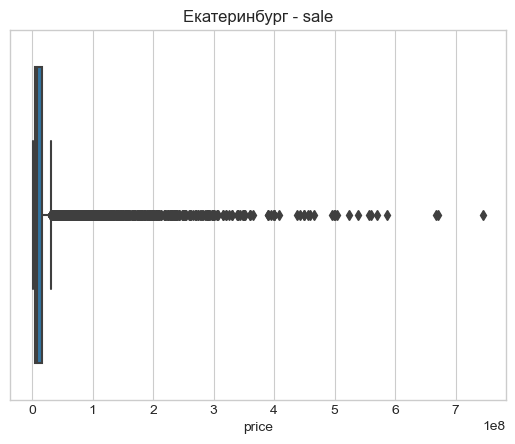

In [11]:
import matplotlib.pyplot as plt
import seaborn as sns

pd.options.mode.chained_assignment = None 

data.sort_values(by=['city','district','house_number','underground','rooms_count','total_meters','author_type'], inplace=True)

#df_table = data.copy()

plt.style.use("seaborn-v0_8-whitegrid")
        
column_list = ["price_per_month","total_meters","price_per_m2", "price"]
        
for t in deal_types:
    
    for city in cities:

        filtered_data = data.query(f'city == "{city}" and deal_type == "{t}"')

        for col in column_list:
            sns.boxplot(x = data[col])
            plt.xlabel(col)
            plt.title(f'{city} - {t}')
            plt.show()

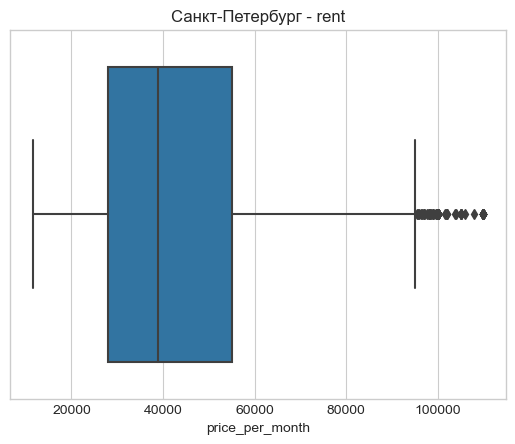

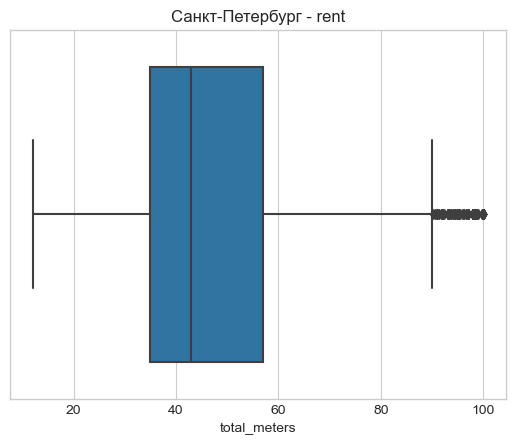

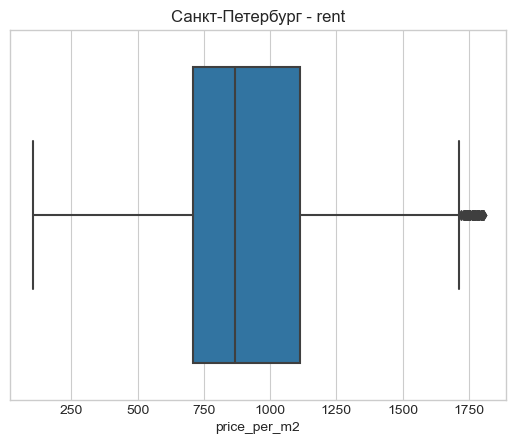

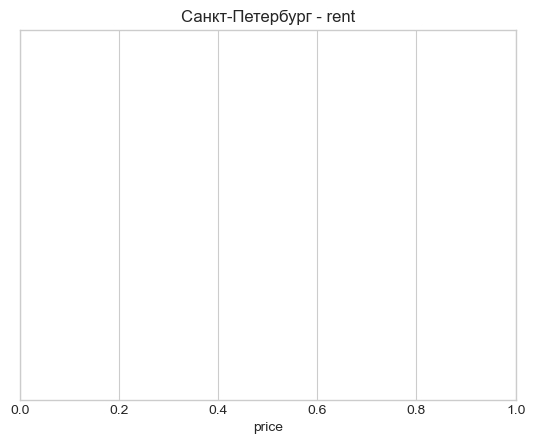

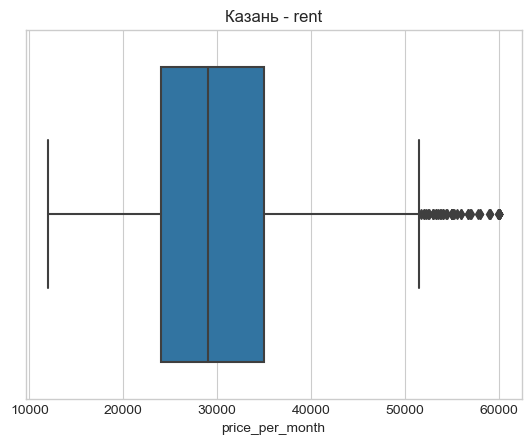

...

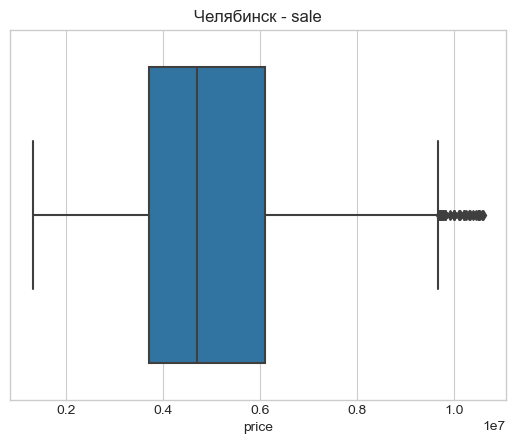

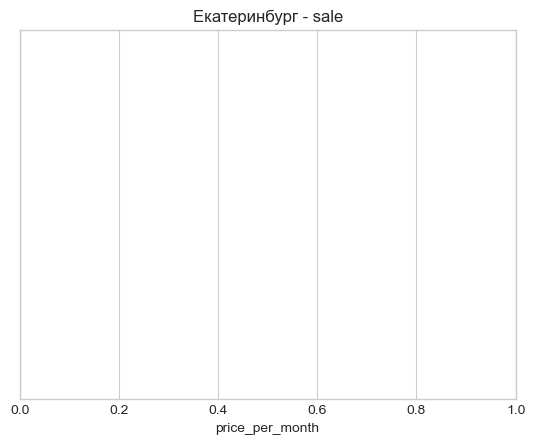

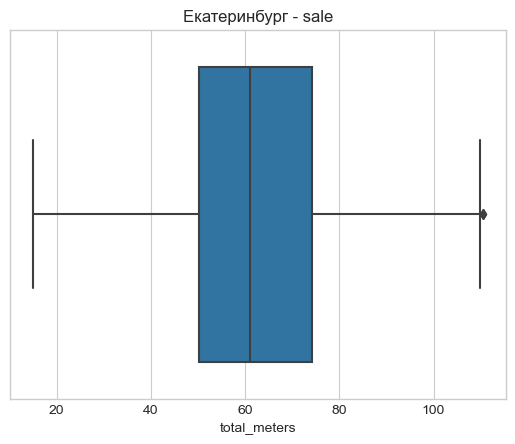

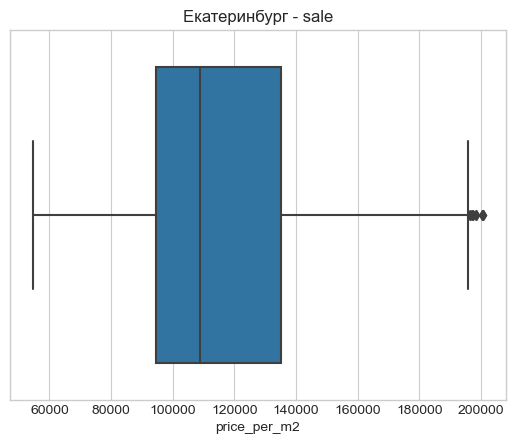

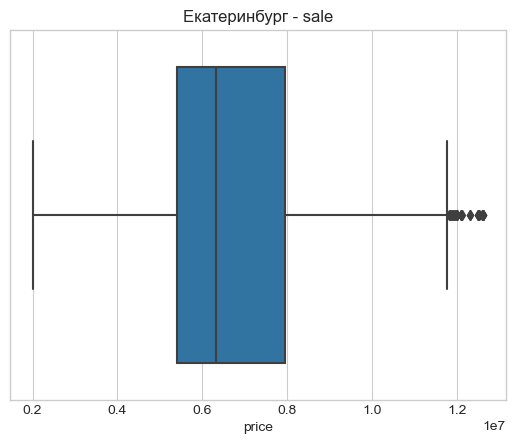

In [12]:
new_data = pd.DataFrame()

for t in deal_types:
    
    for city in cities:

        filtered_data = data.query(f'city == "{city}" and deal_type == "{t}"')
        filtered_data.sort_values(by=['district','house_number','underground','author_type','rooms_count','total_meters'], inplace=True)

        for col in column_list:
            df_table = filtered_data[col]

            Q1 = df_table.quantile(0.25)
            Q3 = df_table.quantile(0.75)
            IQR = Q3 - Q1

            lower_bound = Q1 - 1.5*IQR
            upper_bound = Q3 + 1.5*IQR

            outliers_vector = (df_table < (lower_bound)) | (df_table > (upper_bound))

            outliers_vector = df_table[outliers_vector]
            filtered_data[col][outliers_vector.index.values] = np.nan
            filtered_data[col] = filtered_data[col].interpolate(limit_direction='both')
            
            sns.boxplot(x = filtered_data[col])
            plt.xlabel(col)
            plt.title(f'{city} - {t}')
            plt.show()
            
        new_data = pd.concat([new_data, filtered_data], ignore_index=True)


In [13]:
data = new_data
data

,author,author_type,link,city,deal_type,accommodation_type,floor,floors_count,rooms_count,total_meters,price_per_m2,price_per_month,commissions,district,street,house_number,underground,price,residential_complex
0,ID 74451055,homeowner,https://spb.cian.ru/rent/flat/295251321/,Санкт-Петербург,rent,flat,2,5,1,28.0,1285.0,36000.0,0.0,Адмиралтейский,проспект Римского-Корсакова,1,Спасская,NaN,None
1,Невский Альянс,real_estate_agent,https://spb.cian.ru/rent/flat/295356199/,Санкт-Петербург,rent,flat,4,5,3,82.0,1219.0,100000.0,0.0,Адмиралтейский,Спасский переулок,1/46,Сенная площадь,NaN,None
2,Ирина Кольцова,realtor,https://spb.cian.ru/rent/flat/294690996/,Санкт-Петербург,rent,flat,4,6,2,49.0,1000.0,49000.0,0.0,Адмиралтейский,Спасский переулок,10,Спасская,NaN,None
3,Ирина Кольцова,realtor,https://spb.cian.ru/rent/flat/294690996/,Санкт-Петербург,rent,flat,4,6,2,49.0,1000.0,49000.0,0.0,Адмиралтейский,Спасский переулок,10,Спасская,NaN,None
4,Ринальди,real_estate_agent,https://spb.cian.ru/rent/flat/190745515/,Санкт-Петербург,rent,flat,2,4,1,12.0,1214.0,25000.0,0.0,Адмиралтейский,Лермонтовский проспект,10/53,Технологический институт,NaN,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22803,Обмен.рф - Брусника Обмен,real_estate_agent,https://ekb.cian.ru/sale/flat/295533927/,Екатеринбург,sale,flat,6,19,2,54.3,97421.0,NaN,NaN,мкр. Широкая Речка,Евгения Савкова,31,None,5290000.0,None
22804,Обмен.рф - Брусника Обмен,real_estate_agent,https://ekb.cian.ru/sale/flat/295926165/,Екатеринбург,sale,flat,4,7,2,64.4,93167.0,NaN,NaN,мкр. Широкая Речка,Евгения Савкова,31,None,6000000.0,Суходольский квартал
22805,Самолет Плюс Екатеринбург,real_estate_agent,https://ekb.cian.ru/sale/flat/292652553/,Екатеринбург,sale,flat,10,25,3,63.9,97026.0,NaN,NaN,мкр. Широкая Речка,Евгения Савкова,35/2,None,6200000.0,None
22806,Диал,real_estate_agent,https://ekb.cian.ru/sale/flat/294439145/,Екатеринбург,sale,flat,3,19,1,36.0,99722.0,NaN,NaN,мкр. Широкая Речка,Суходольская,47,None,3590000.0,None


### Построение графиков

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


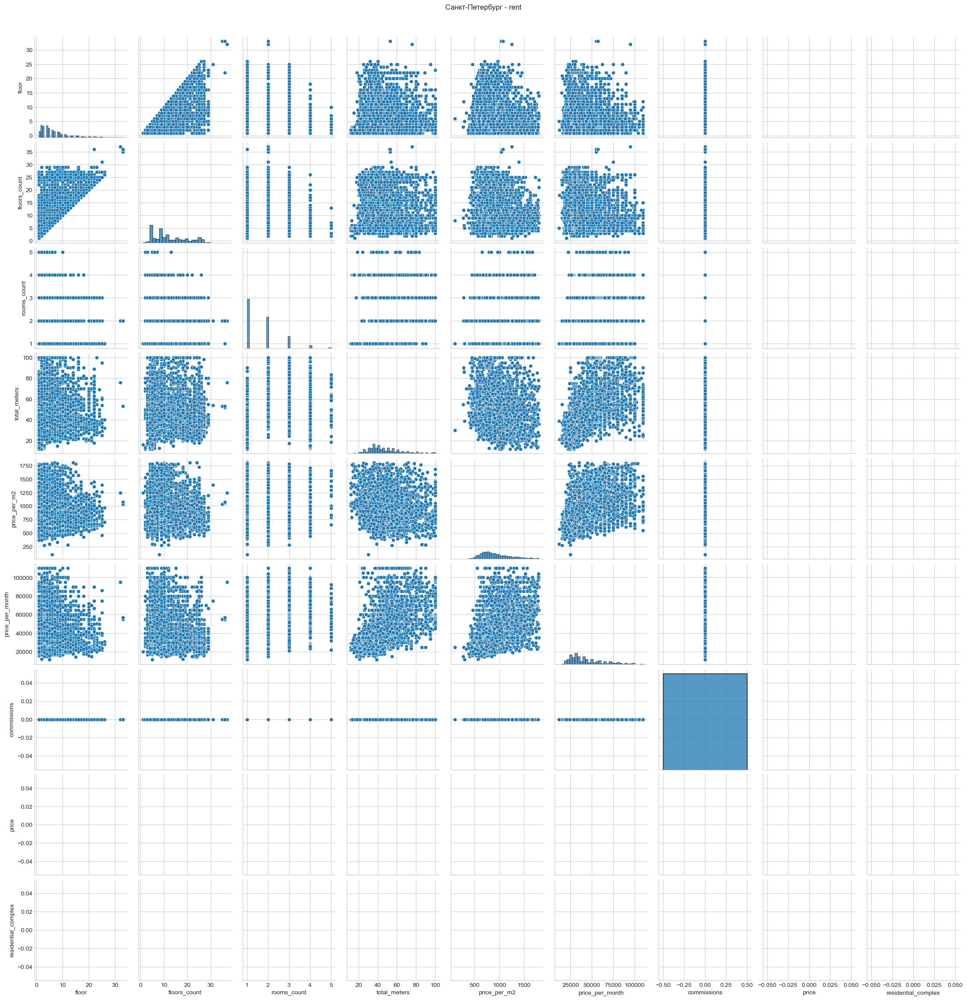

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


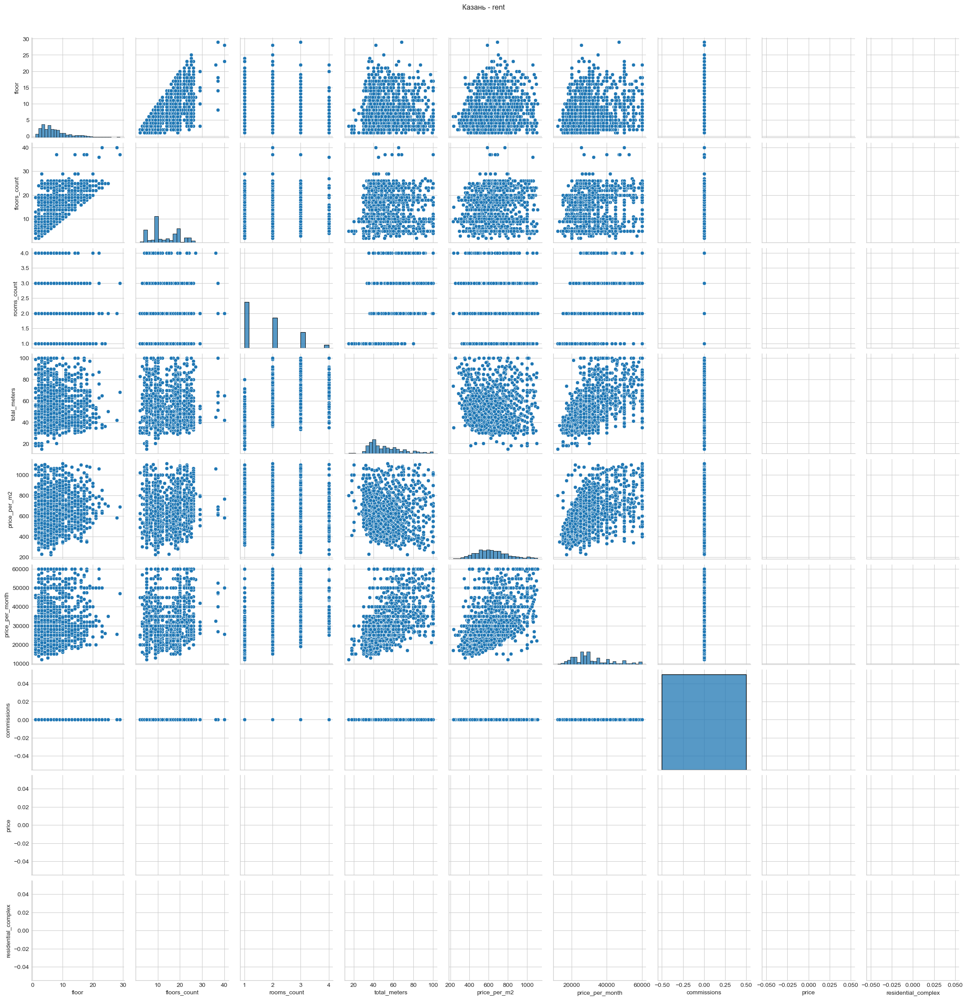

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


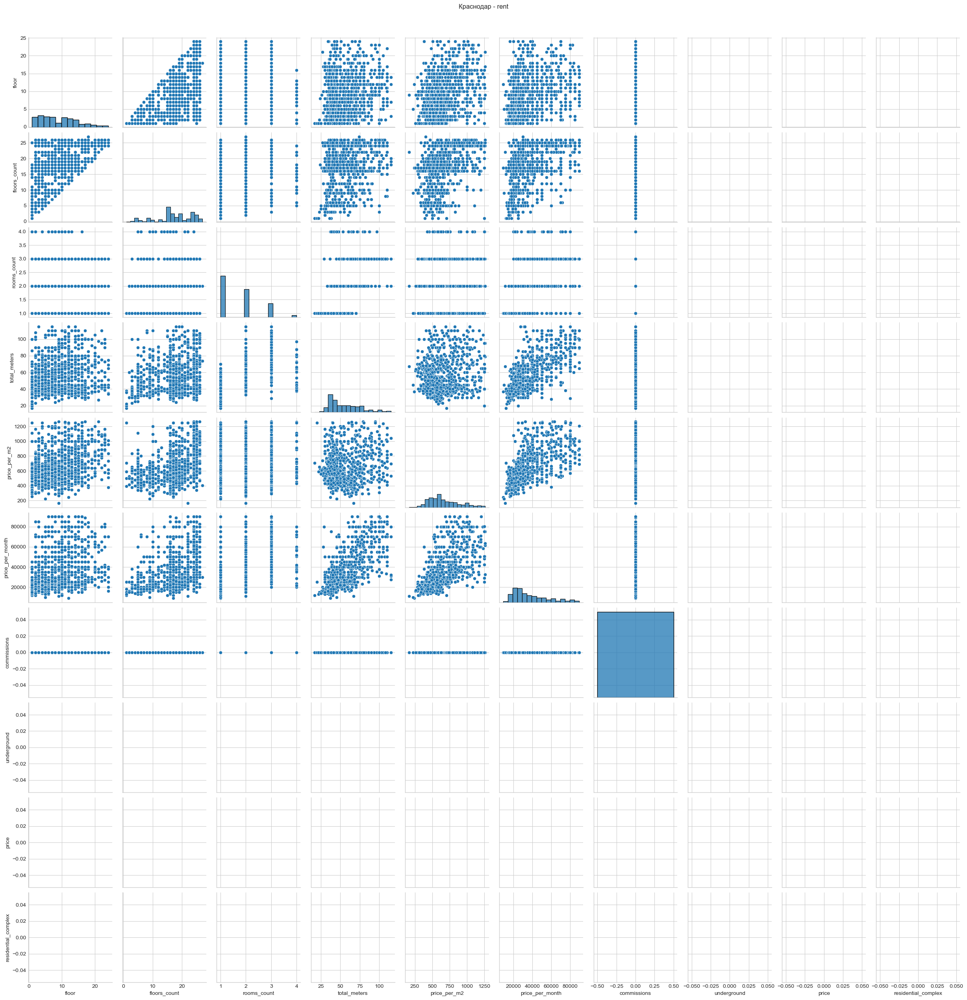

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


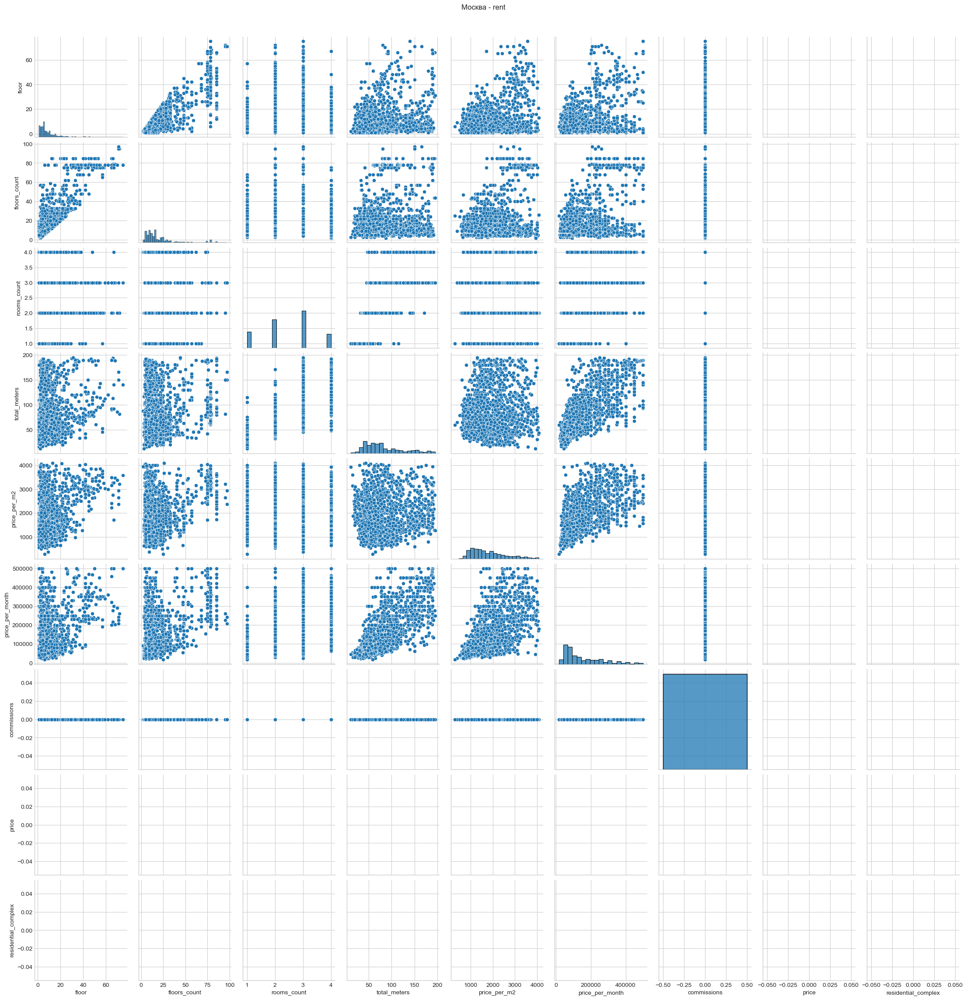

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


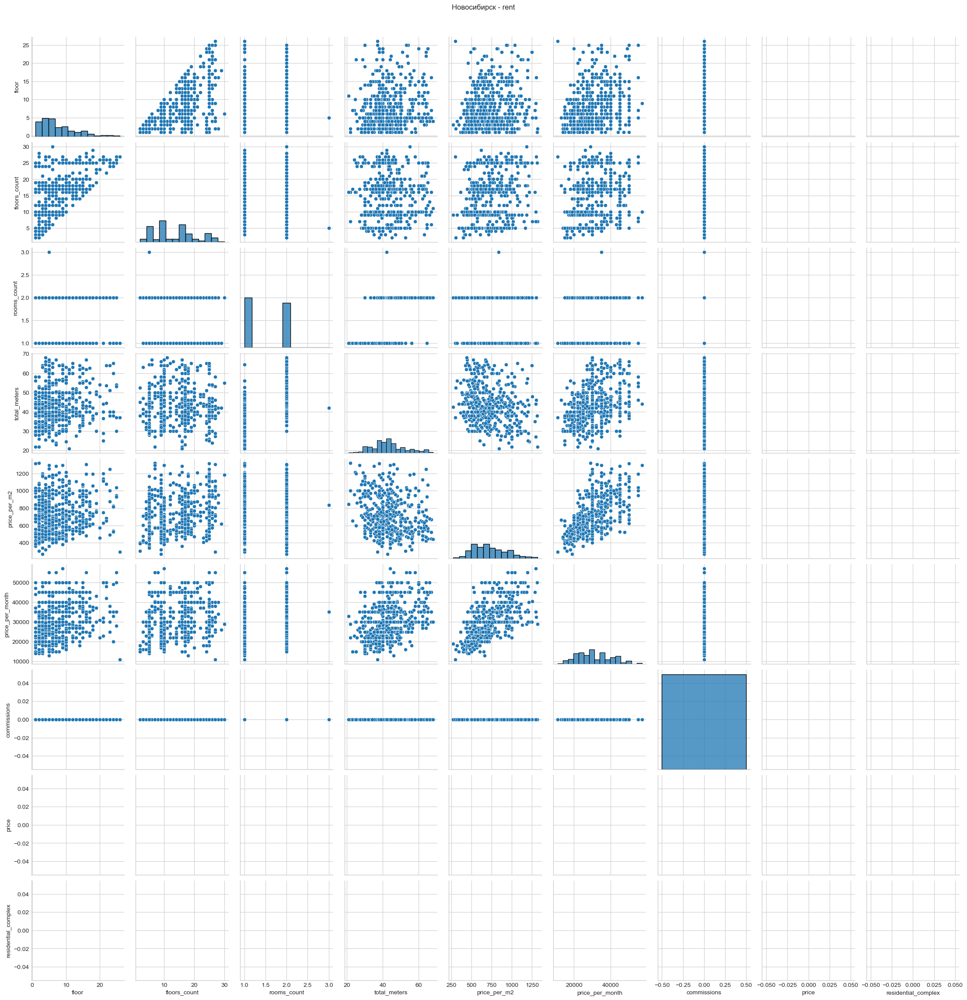

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


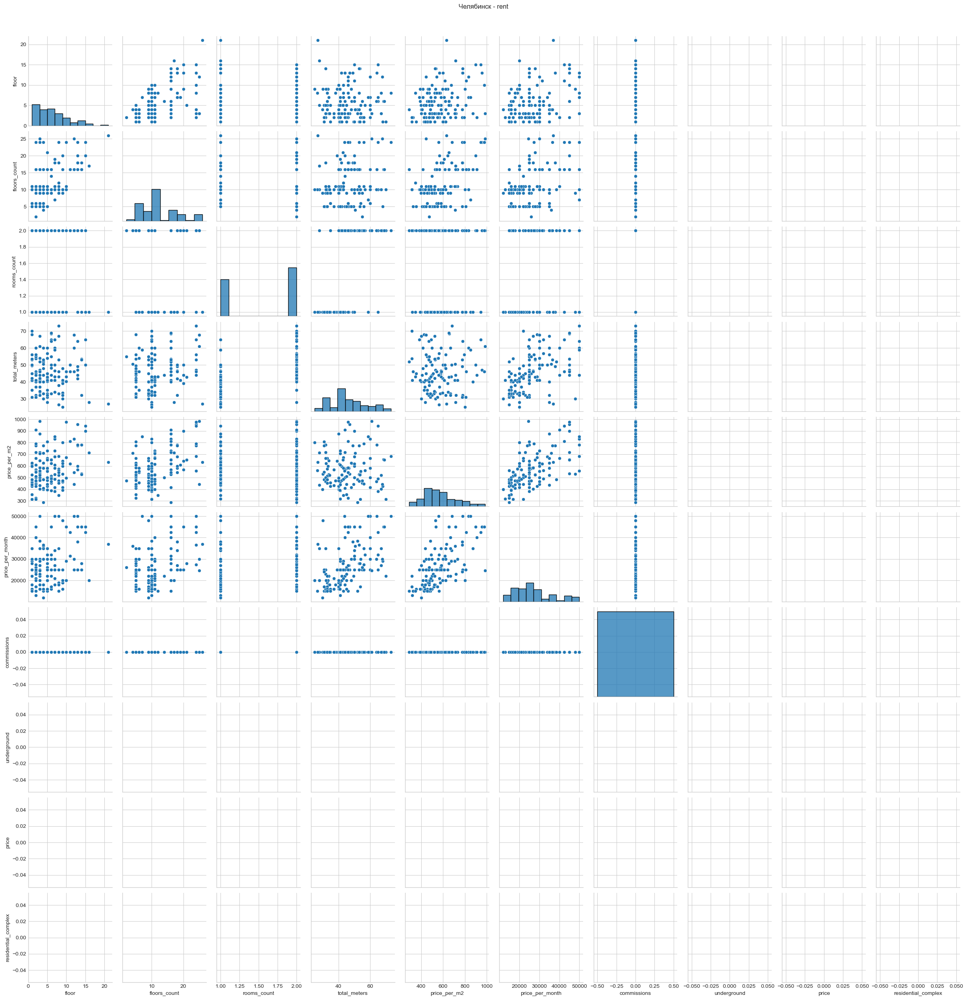

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


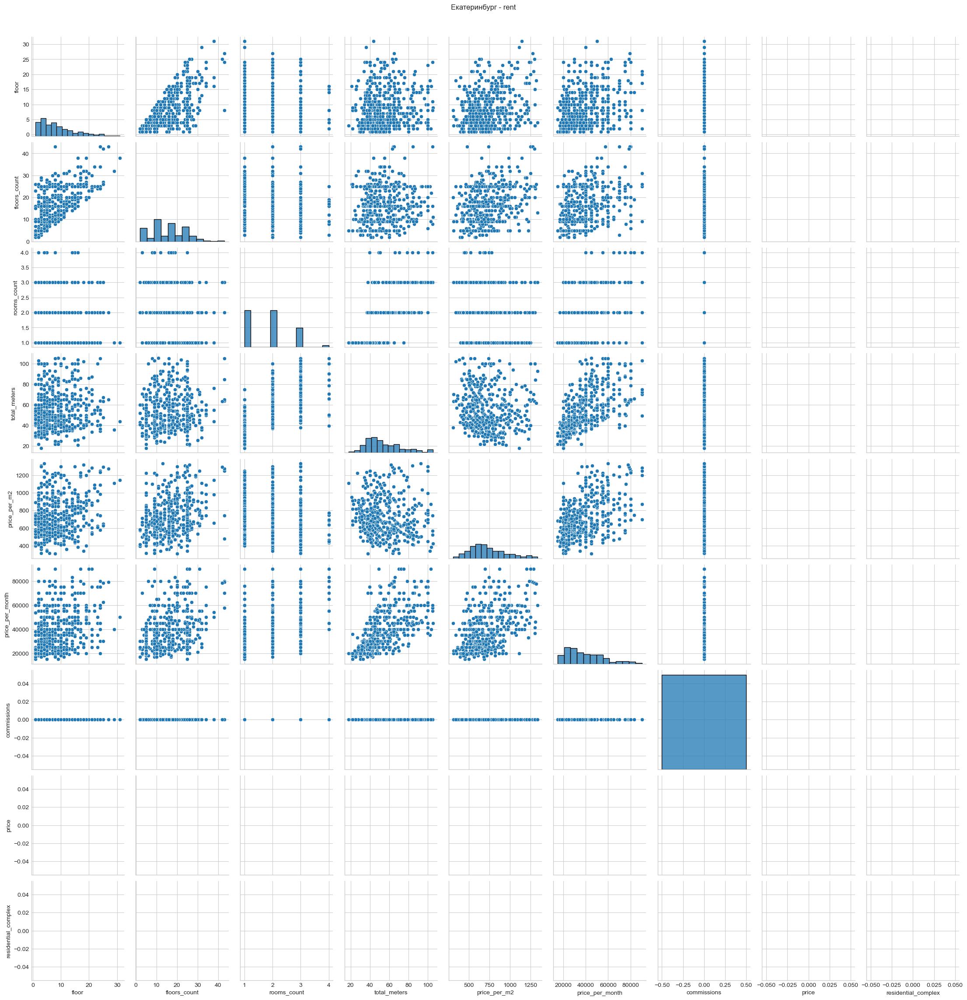

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


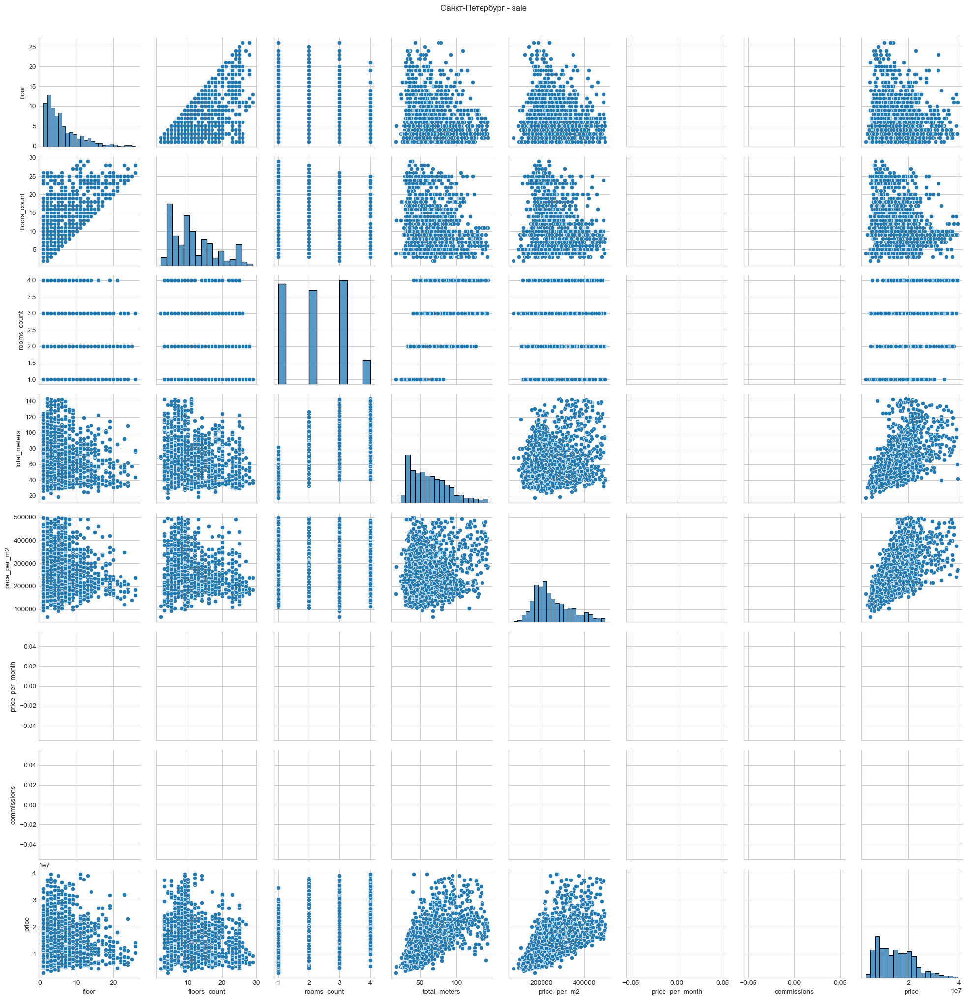

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


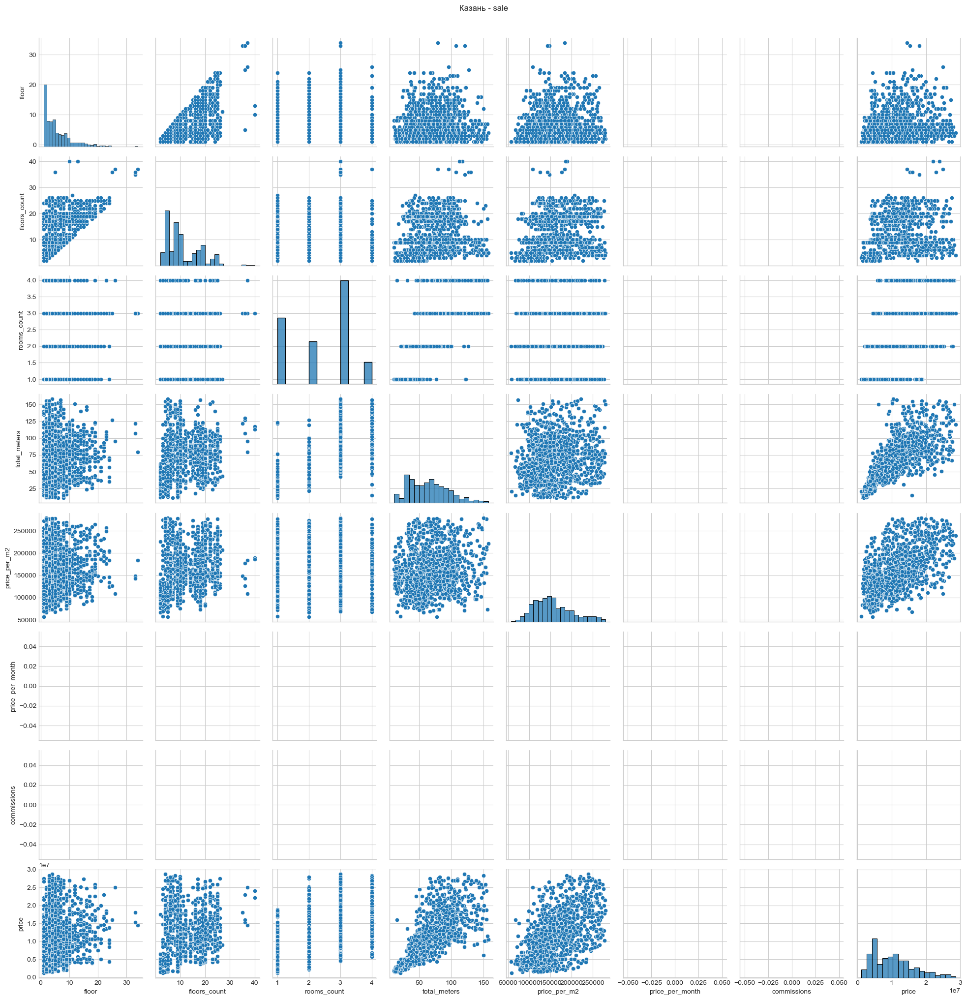

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


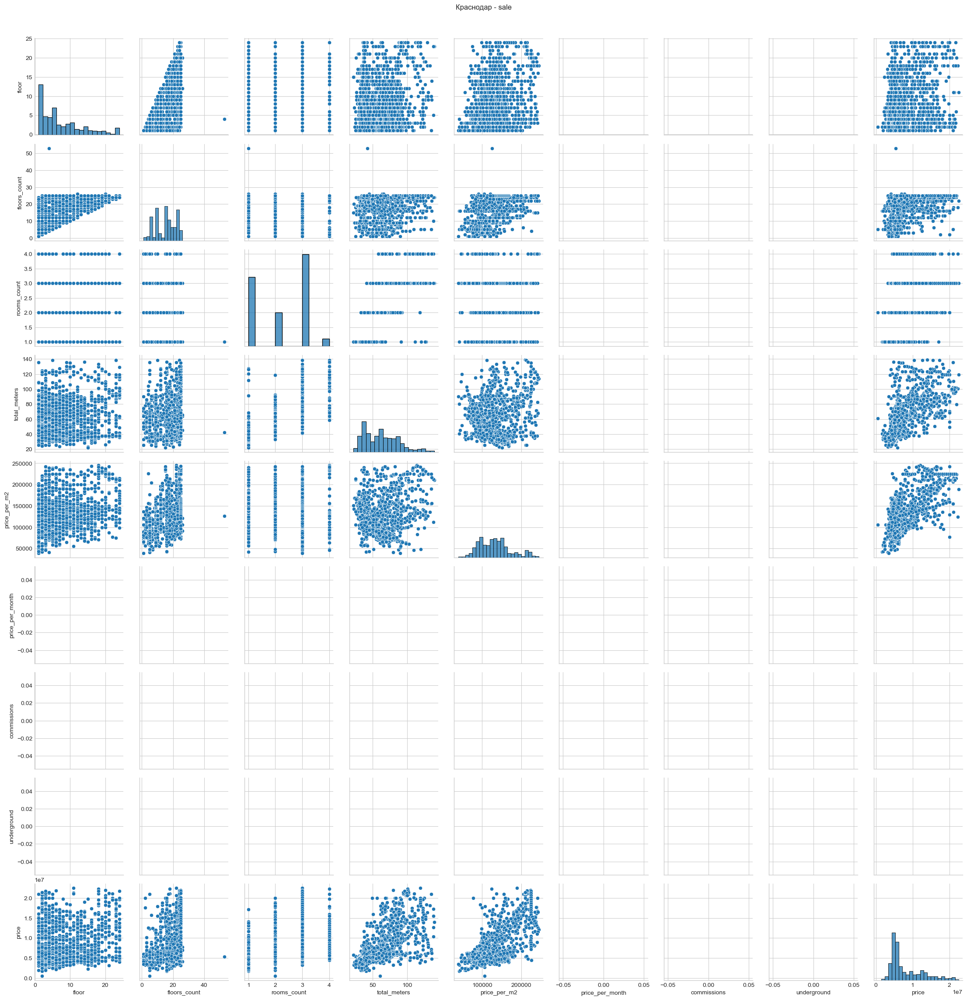

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


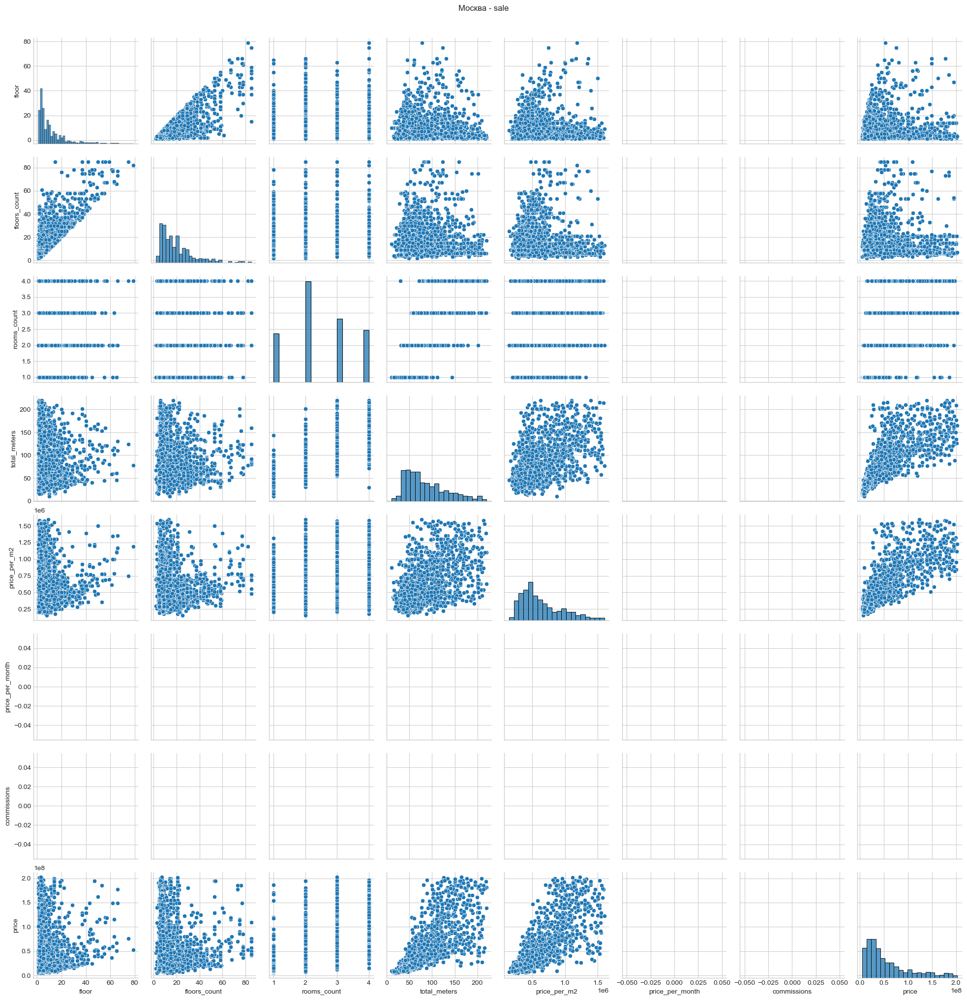

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


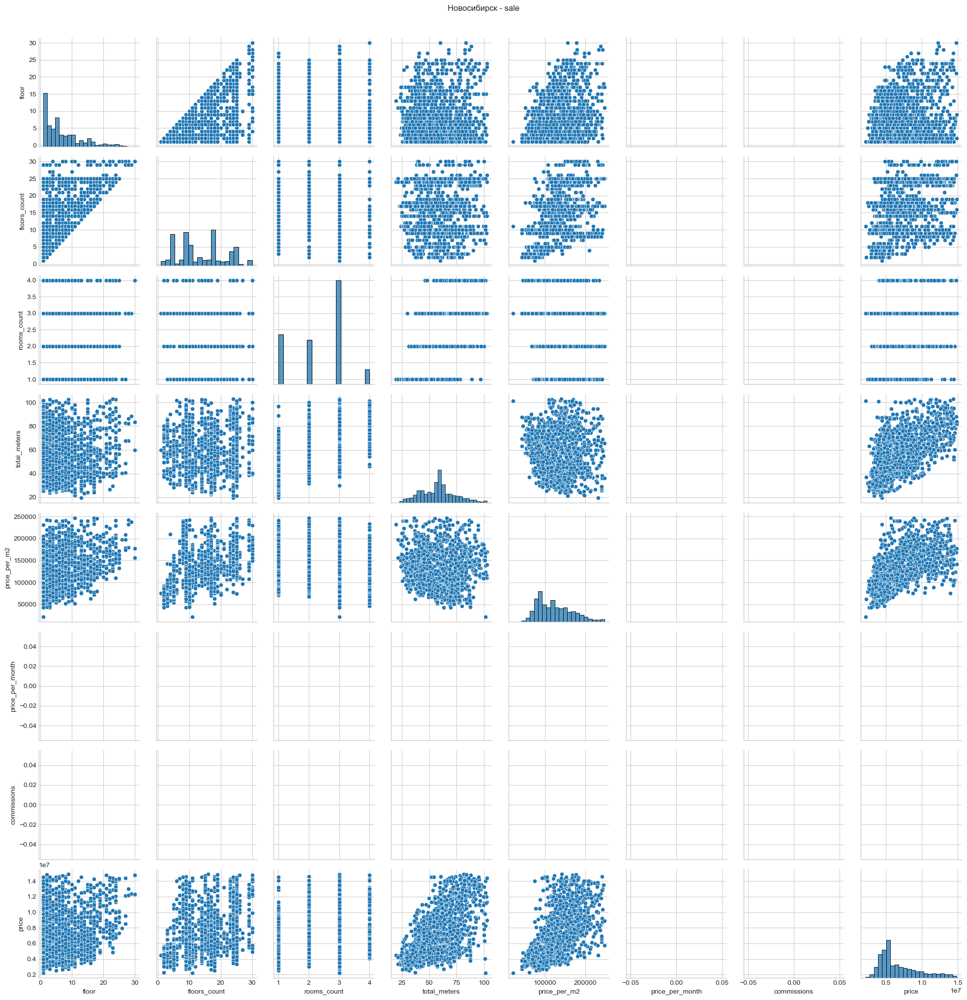

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


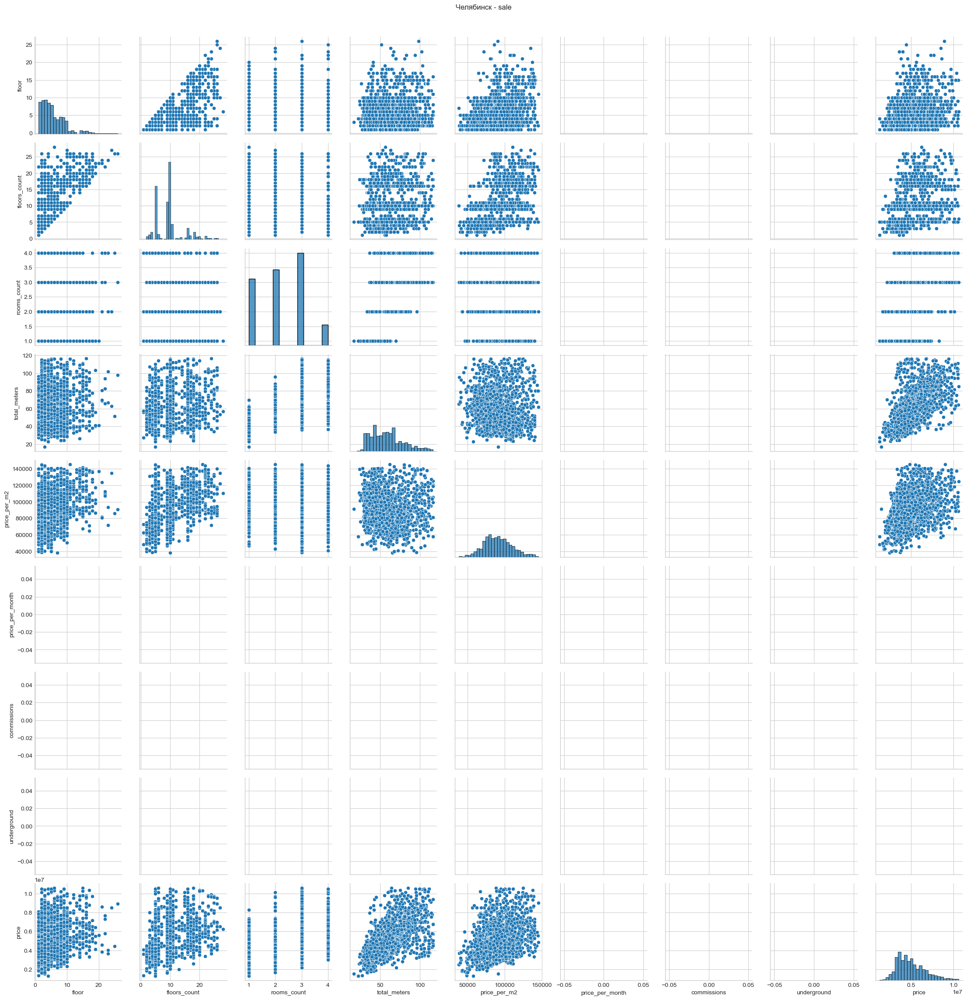

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


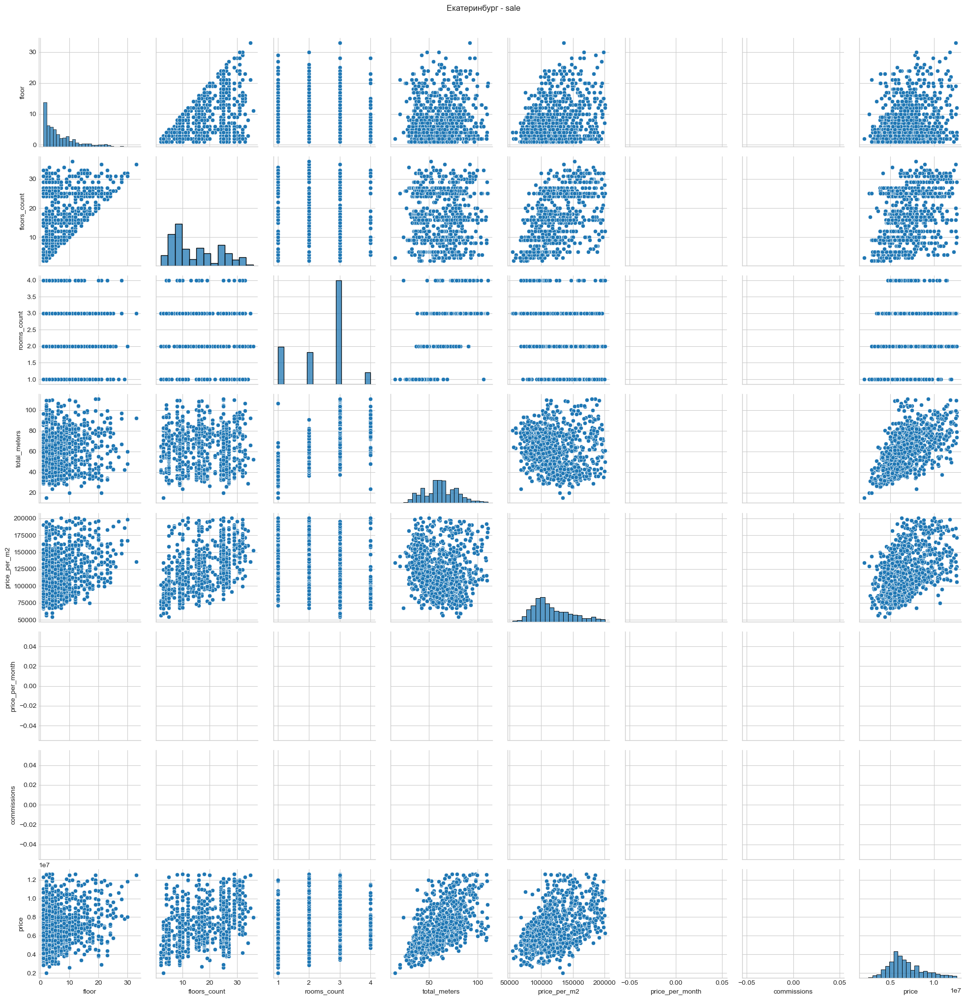

In [14]:
for t in deal_types:
    
    for city in cities:

        filtered_data = data.query(f'city == "{city}" and deal_type == "{t}"')

        plot = sns.pairplot(filtered_data)
        plot.fig.suptitle(f'{city} - {t}', y=1.02)
        plt.show()

### Распределение цены от района

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\2028559413.py:11: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


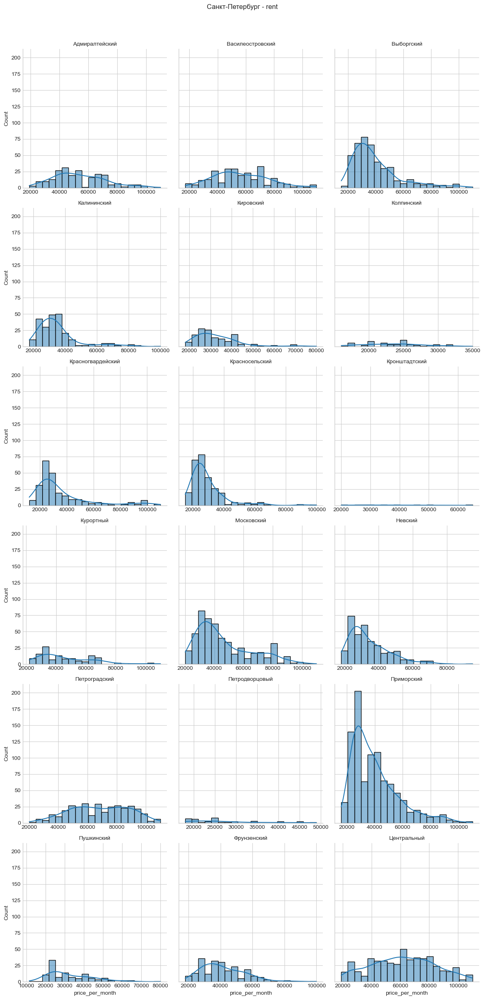

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\2028559413.py:11: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


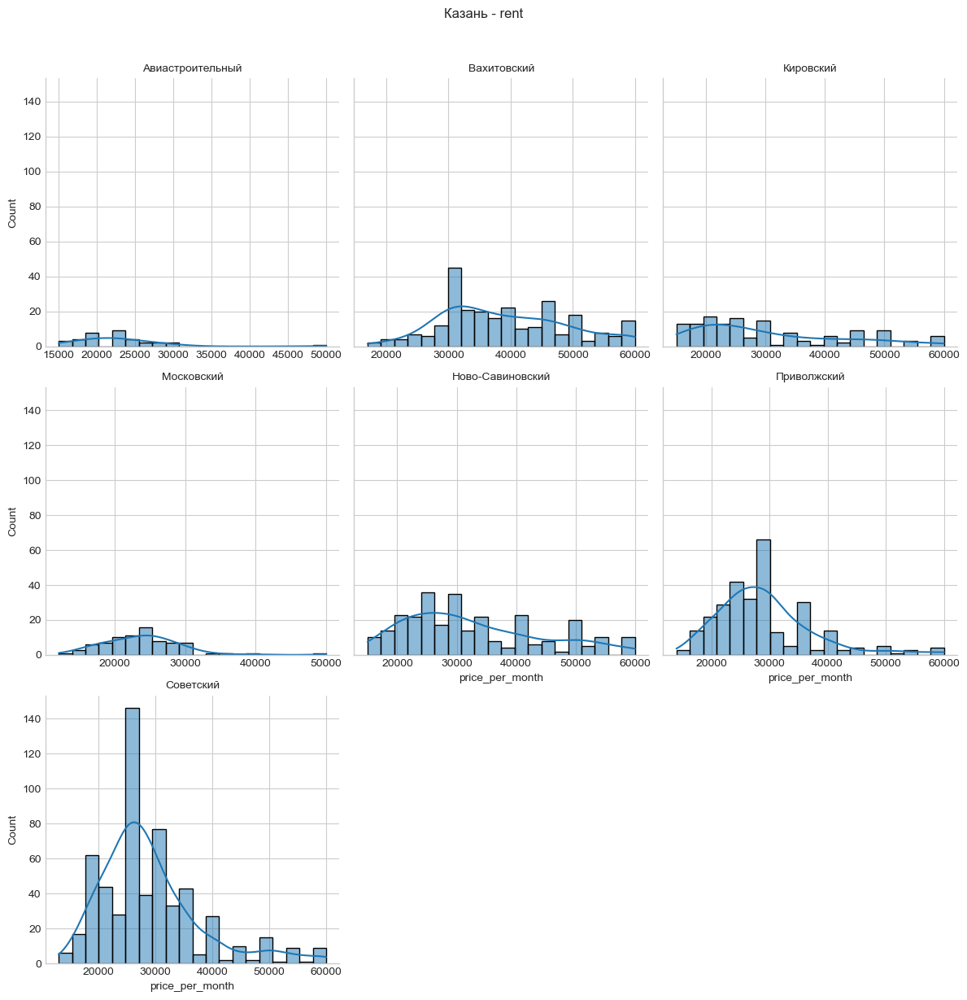

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\2028559413.py:11: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


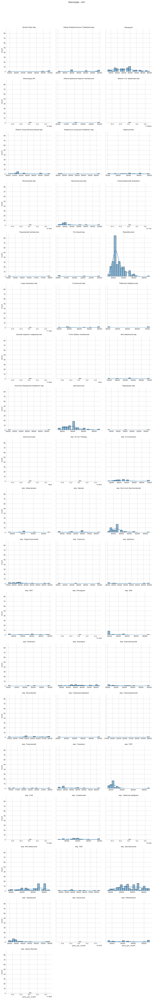

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\2028559413.py:11: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


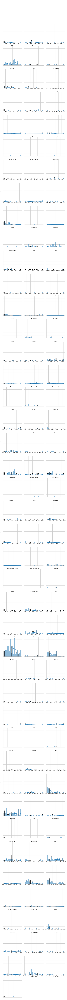

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\2028559413.py:11: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


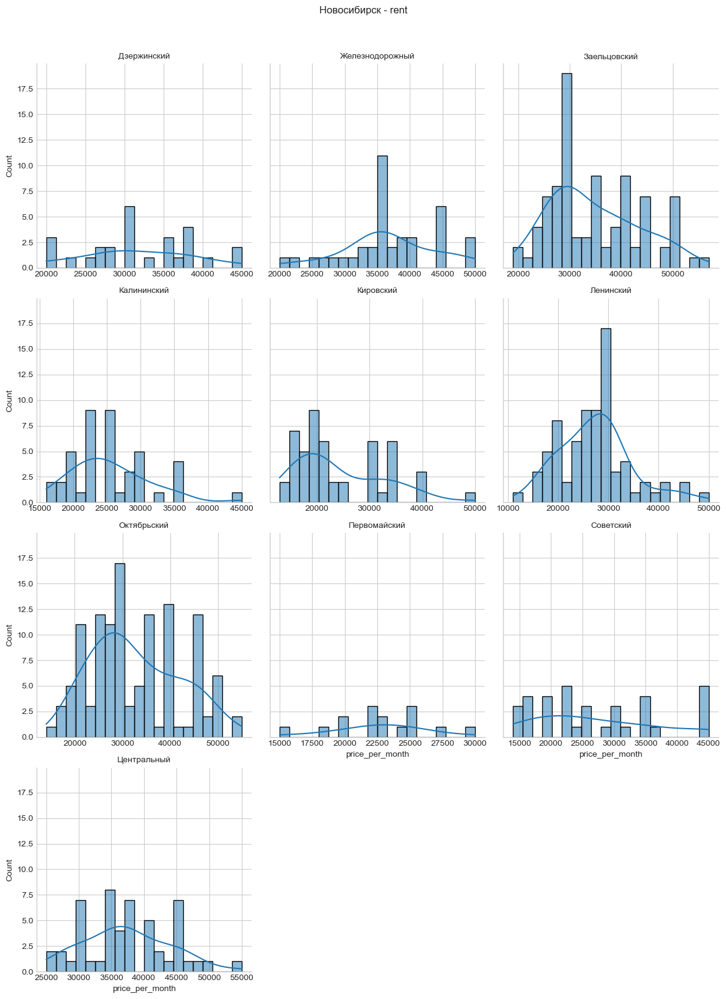

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\2028559413.py:11: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


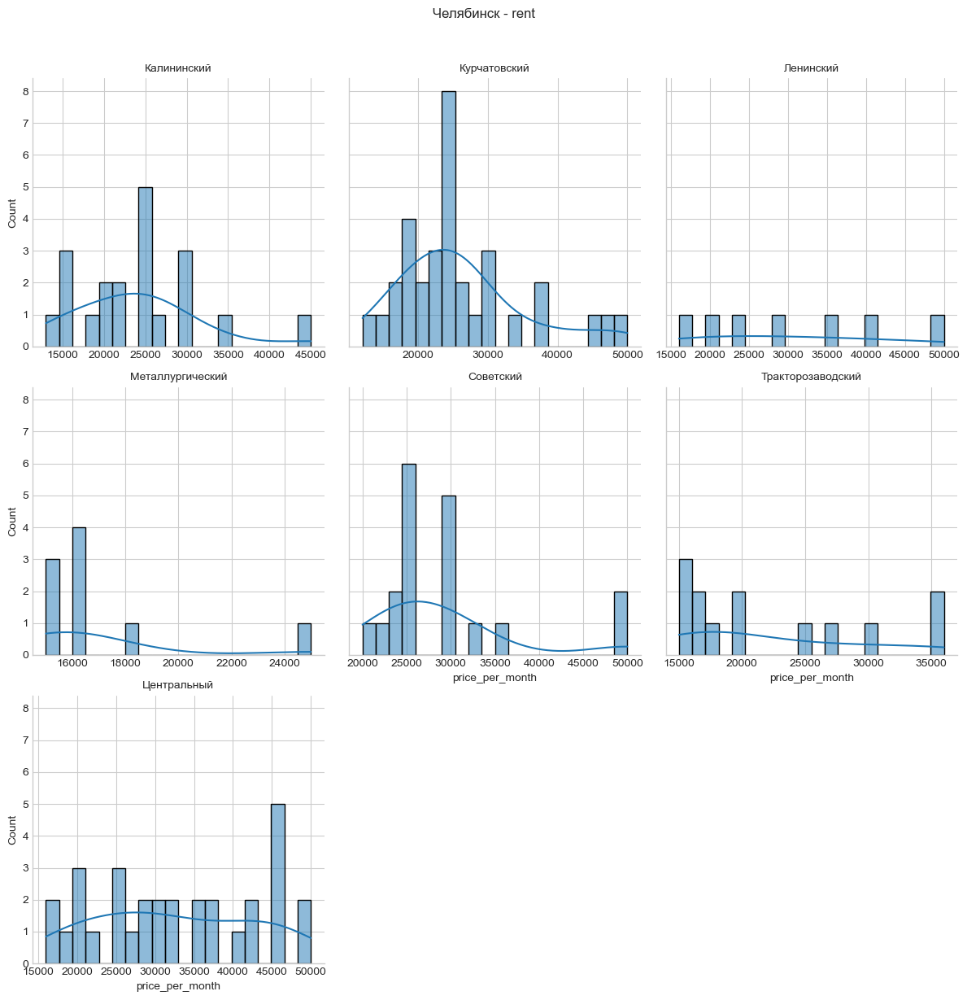

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\2028559413.py:11: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


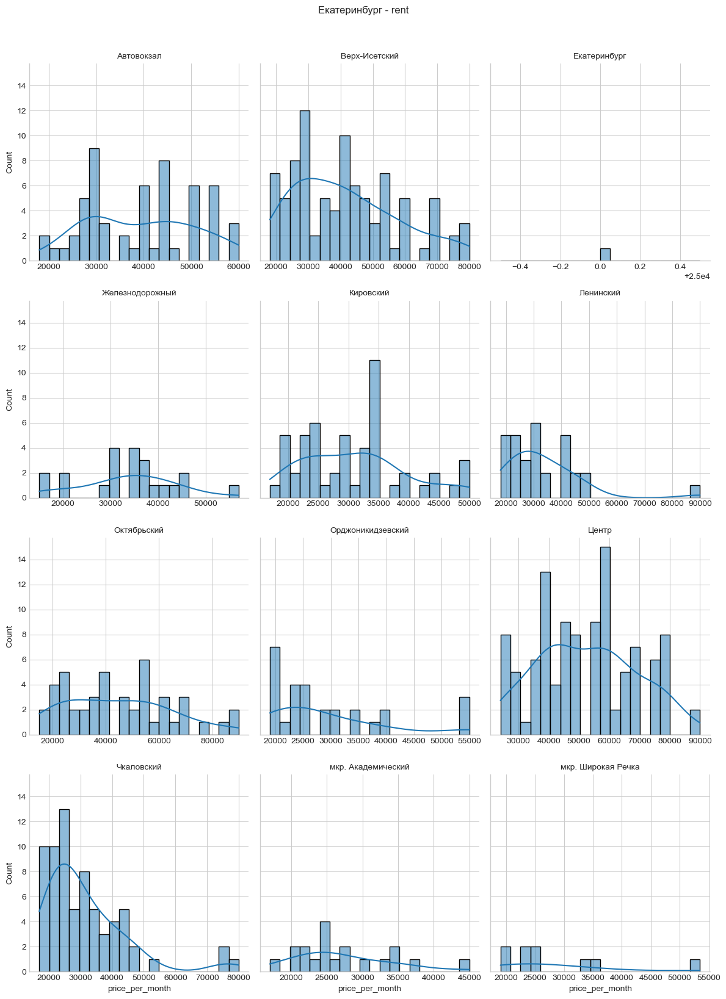

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\2028559413.py:11: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


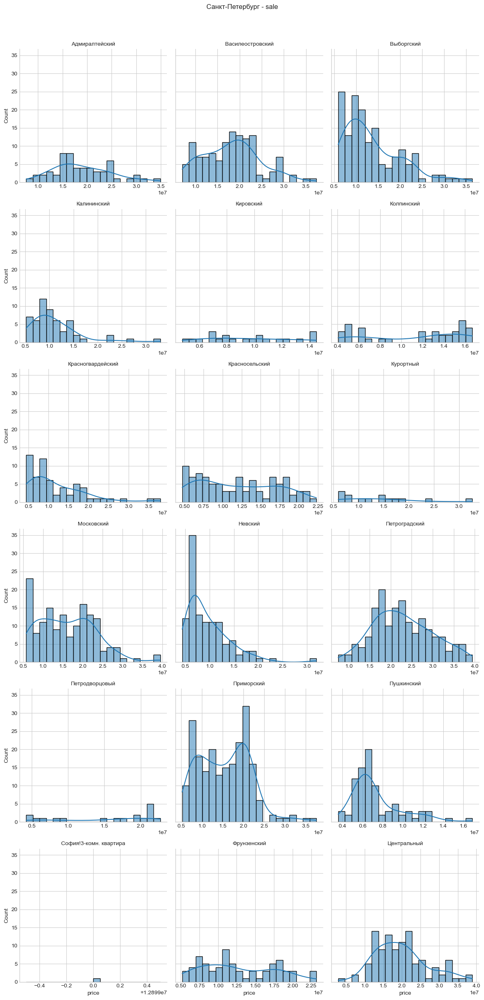

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\2028559413.py:11: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


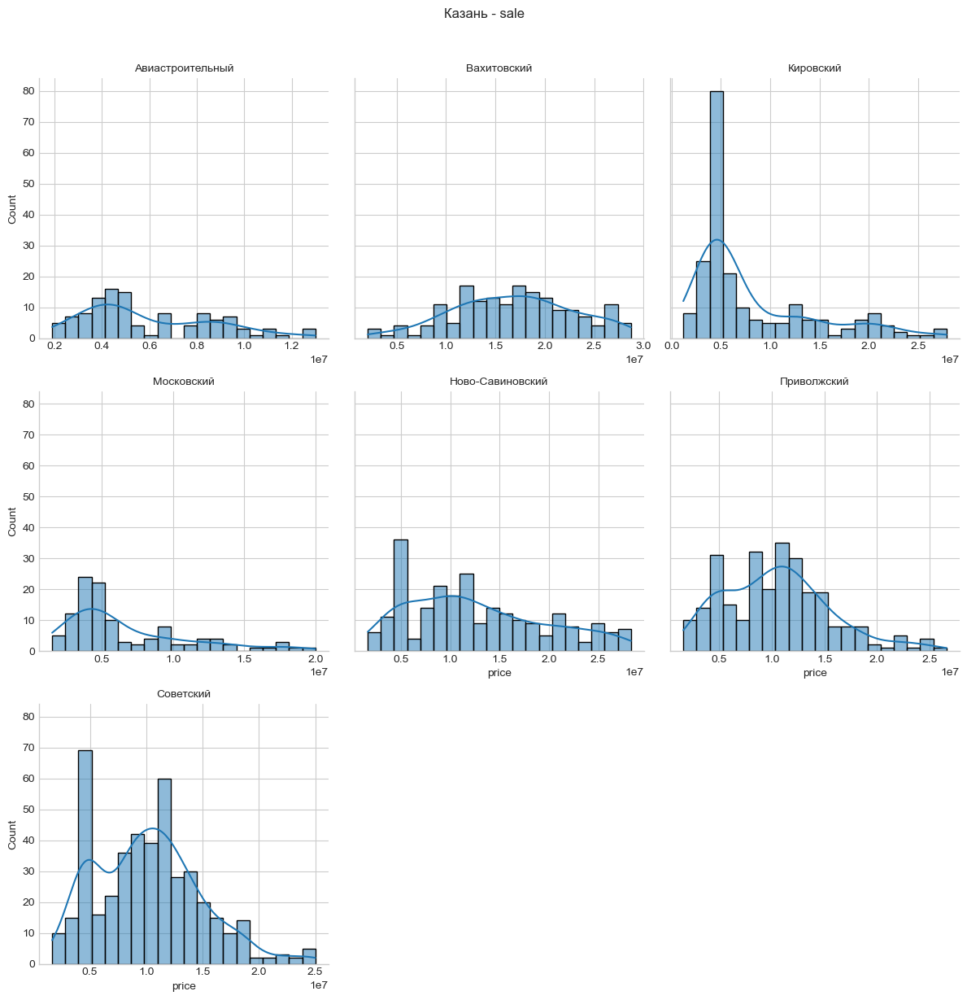

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\2028559413.py:11: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


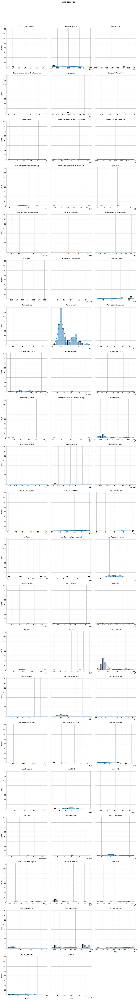

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\2028559413.py:11: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


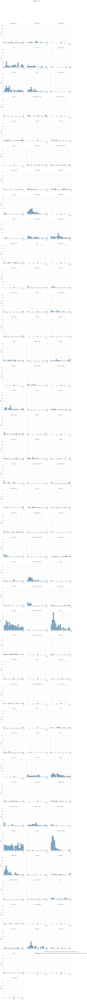

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\2028559413.py:11: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


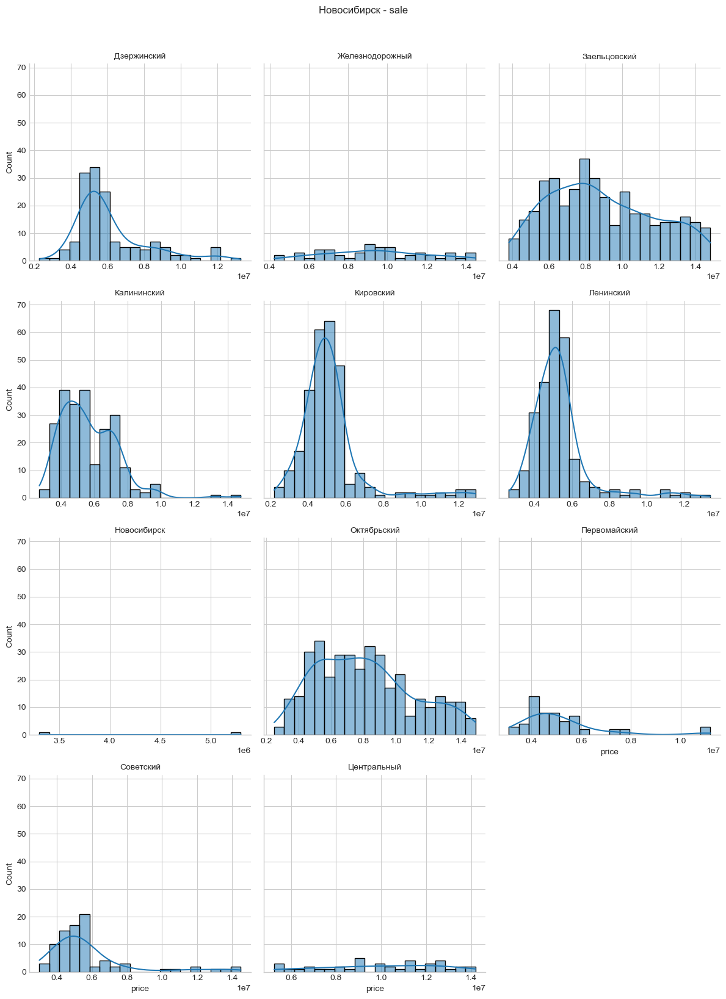

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\2028559413.py:11: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


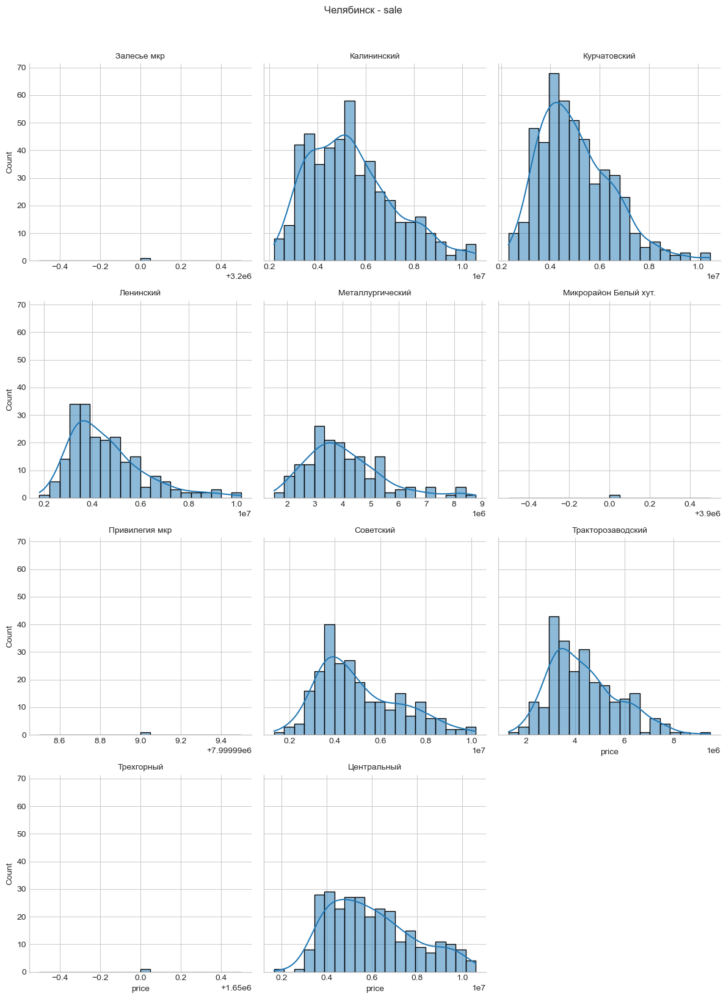

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\2028559413.py:11: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


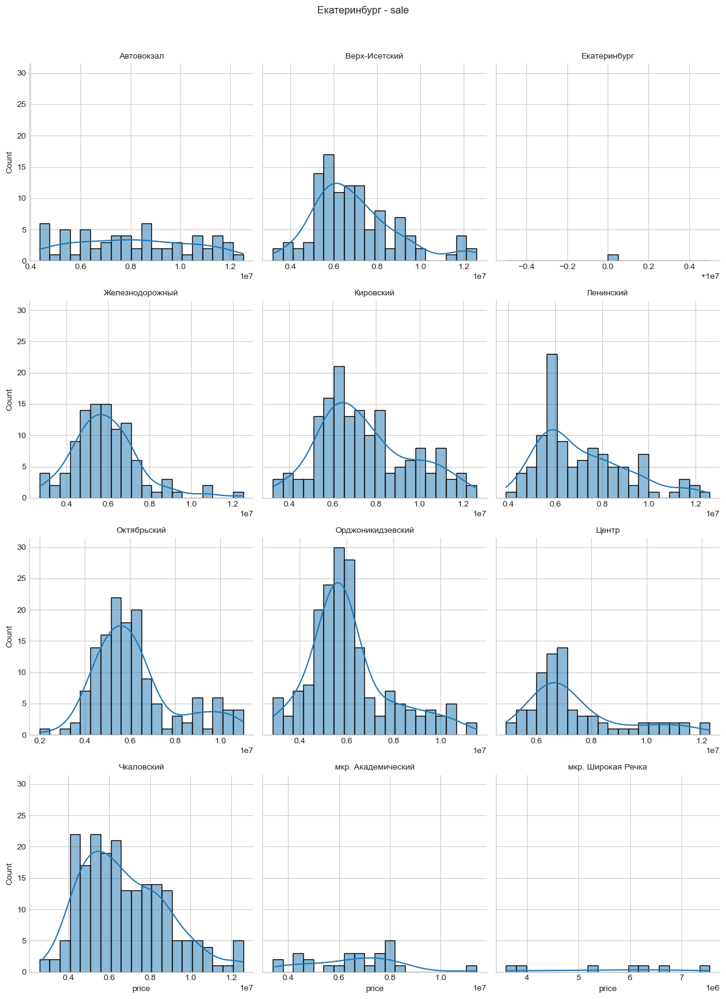

In [15]:
for t in deal_types:
    
    for city in cities:

        filtered_data = data.query(f'city == "{city}" and deal_type == "{t}"')
        parameter = 'price_per_month' if t == 'rent' else 'price'
        g = sns.FacetGrid(filtered_data, col='district', col_wrap=3, height=4, sharex=False)
        g.fig.suptitle(f'{city} - {t}', y=1.02)
        g.map(sns.histplot, parameter, bins=20, kde=True)
        g.set_titles('{col_name}')
        plt.tight_layout()
        plt.show()

### Распределение цены от метро

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\2685792308.py:14: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


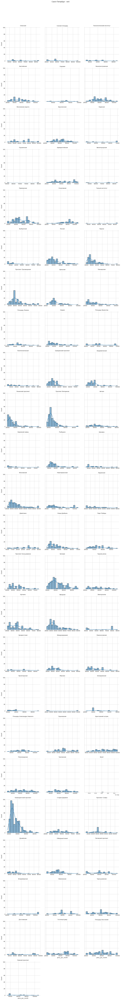

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\2685792308.py:14: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


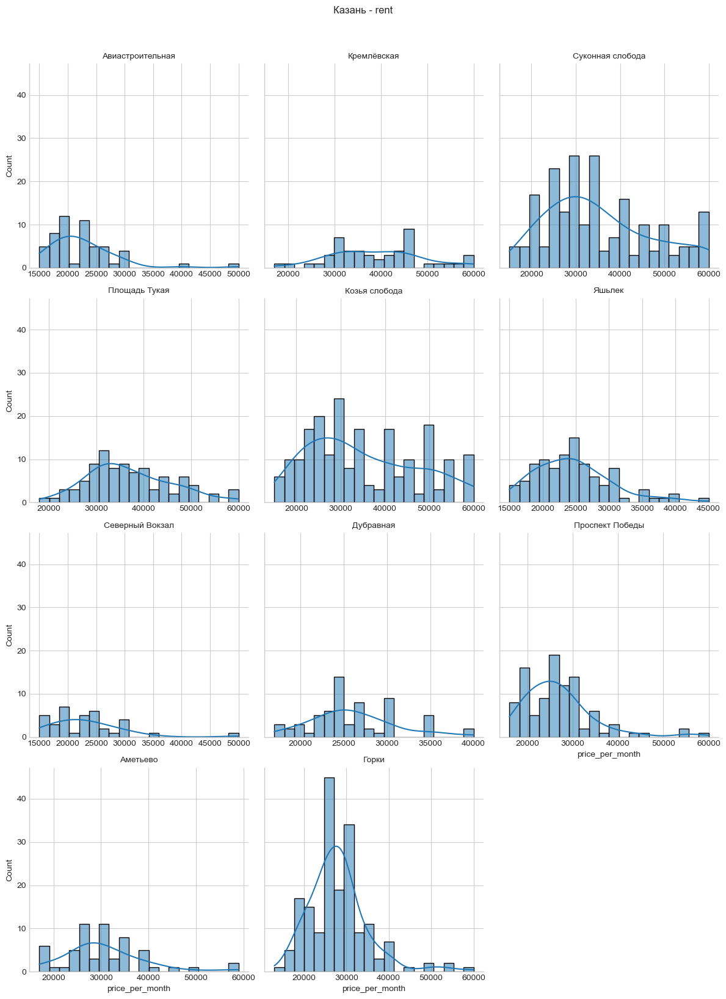

ValueError: Number of rows must be a positive integer, not 0

<Figure size 1200x0 with 0 Axes>

In [16]:
for t in deal_types:
    
    for city in cities:

        filtered_data = data.query(f'city == "{city}" and deal_type == "{t}"')
        parameter = 'price_per_month' if t == 'rent' else 'price'
        
        if (filtered_data.shape[0] > 0):
            
            g = sns.FacetGrid(filtered_data, col='underground', col_wrap=3, height=4, sharex=False)
            g.fig.suptitle(f'{city} - {t}', y=1.02)
            g.map(sns.histplot, parameter, bins=20, kde=True)
            g.set_titles('{col_name}')
            plt.tight_layout()
            plt.show()


### Распределение цен

C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\403109159.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(filtered_data[parameter]).set_title(f'{city} - {t}')


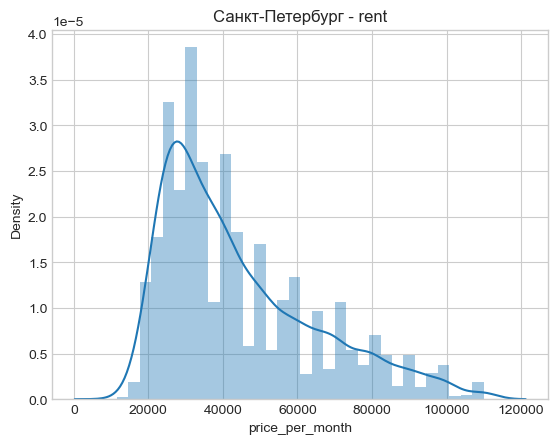

C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\403109159.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(filtered_data[parameter]).set_title(f'{city} - {t}')


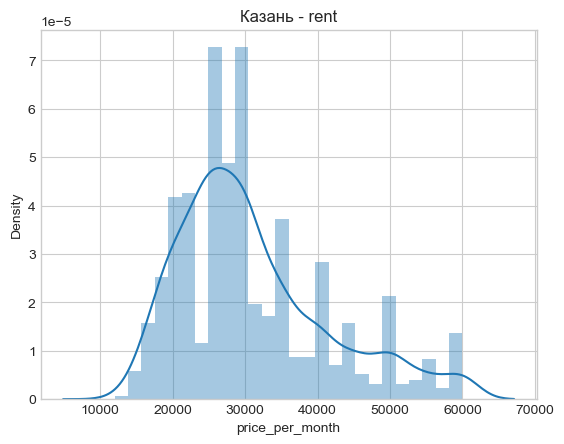

C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\403109159.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(filtered_data[parameter]).set_title(f'{city} - {t}')


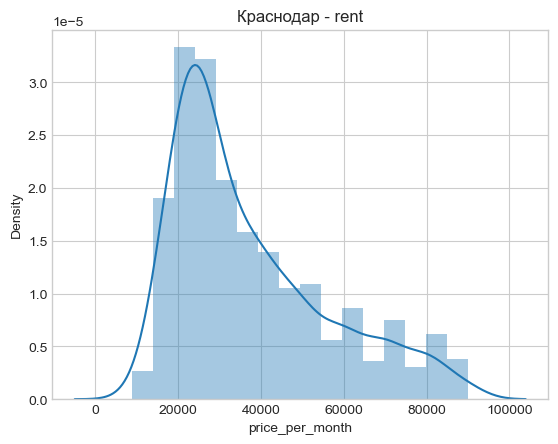

C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\403109159.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(filtered_data[parameter]).set_title(f'{city} - {t}')


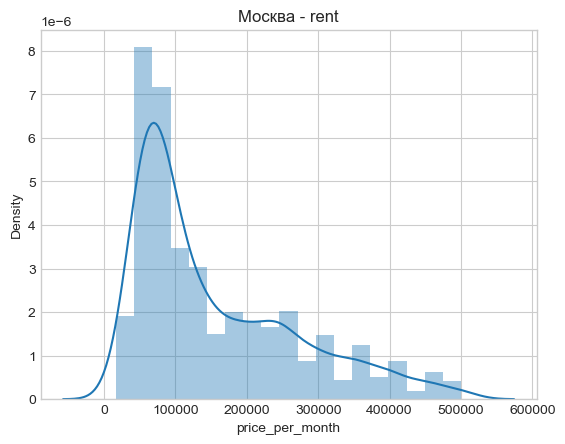

C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\403109159.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(filtered_data[parameter]).set_title(f'{city} - {t}')


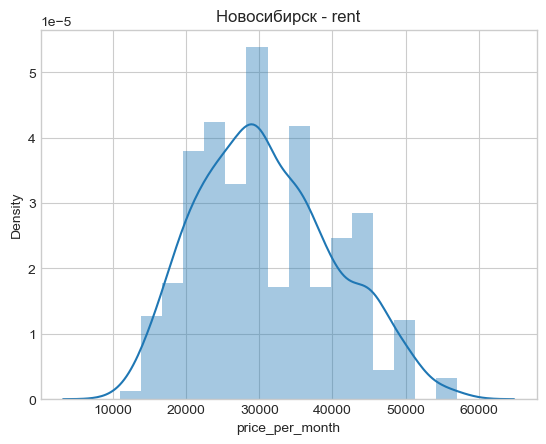

C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\403109159.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(filtered_data[parameter]).set_title(f'{city} - {t}')


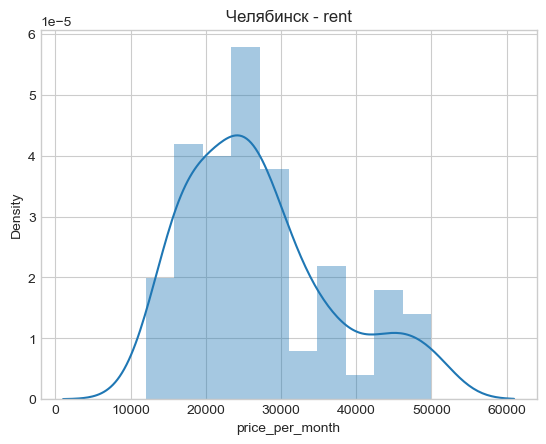

C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\403109159.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(filtered_data[parameter]).set_title(f'{city} - {t}')


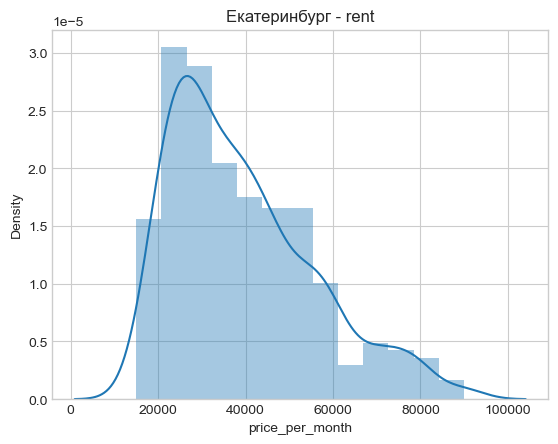

C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\403109159.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(filtered_data[parameter]).set_title(f'{city} - {t}')


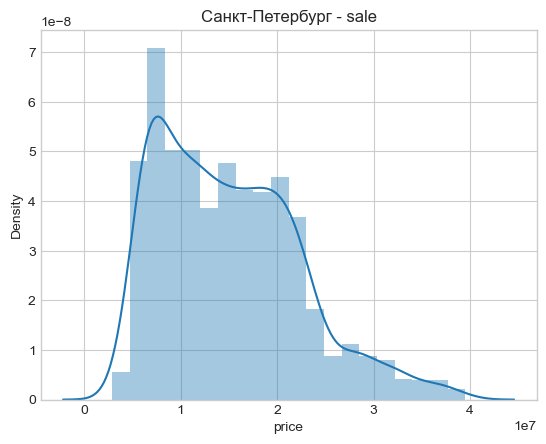

C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\403109159.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(filtered_data[parameter]).set_title(f'{city} - {t}')


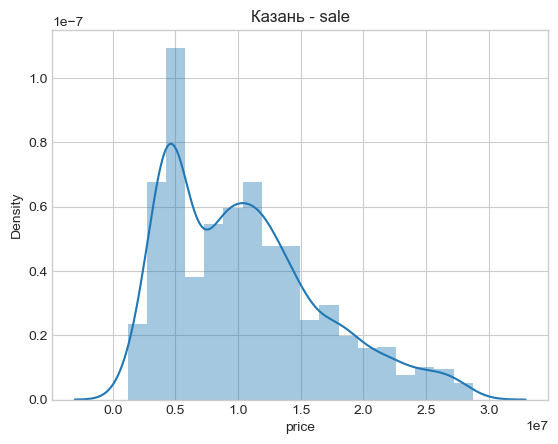

C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\403109159.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(filtered_data[parameter]).set_title(f'{city} - {t}')


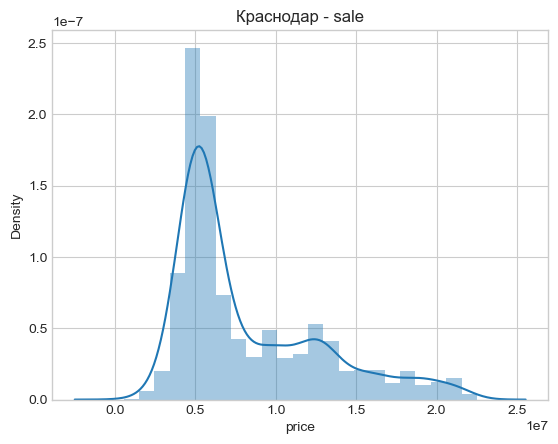

C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\403109159.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(filtered_data[parameter]).set_title(f'{city} - {t}')


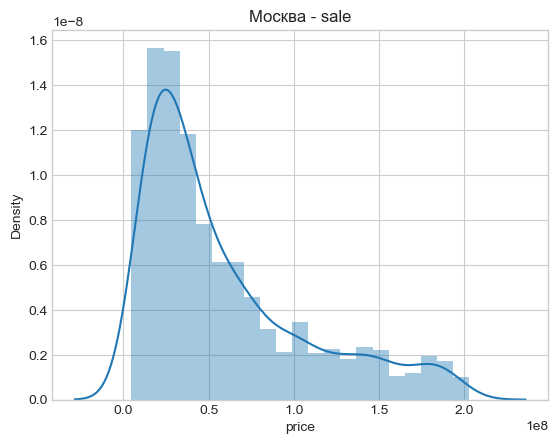

C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\403109159.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(filtered_data[parameter]).set_title(f'{city} - {t}')


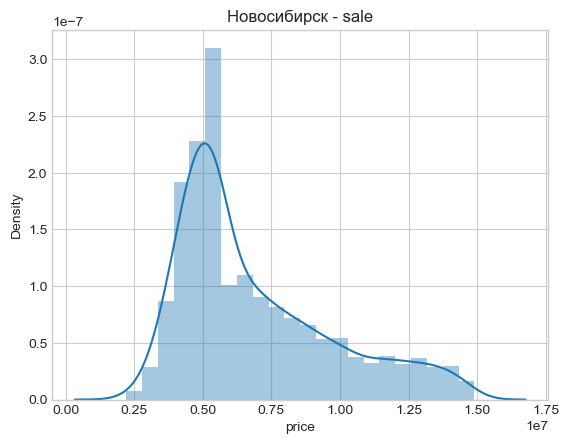

C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\403109159.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(filtered_data[parameter]).set_title(f'{city} - {t}')


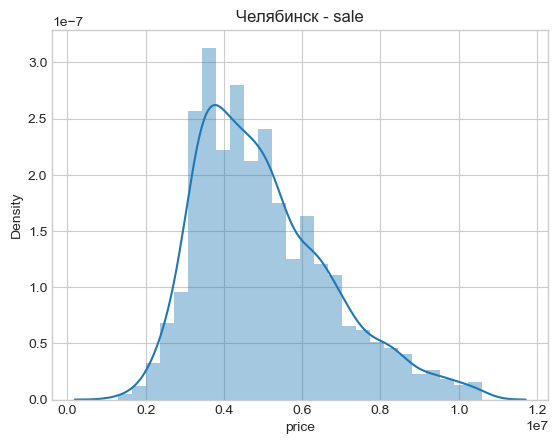

C:\Users\andvi\AppData\Local\Temp\ipykernel_2992\403109159.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(filtered_data[parameter]).set_title(f'{city} - {t}')


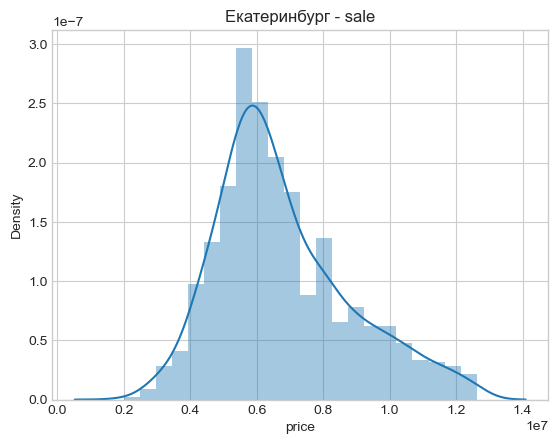

In [17]:
for t in deal_types:
    
    for city in cities:

        filtered_data = data.query(f'city == "{city}" and deal_type == "{t}"')
        parameter = 'price_per_month' if t == 'rent' else 'price'
        sns.distplot(filtered_data[parameter]).set_title(f'{city} - {t}')

        plt.show()
        

### Процент объявлении из разных категорией авторов

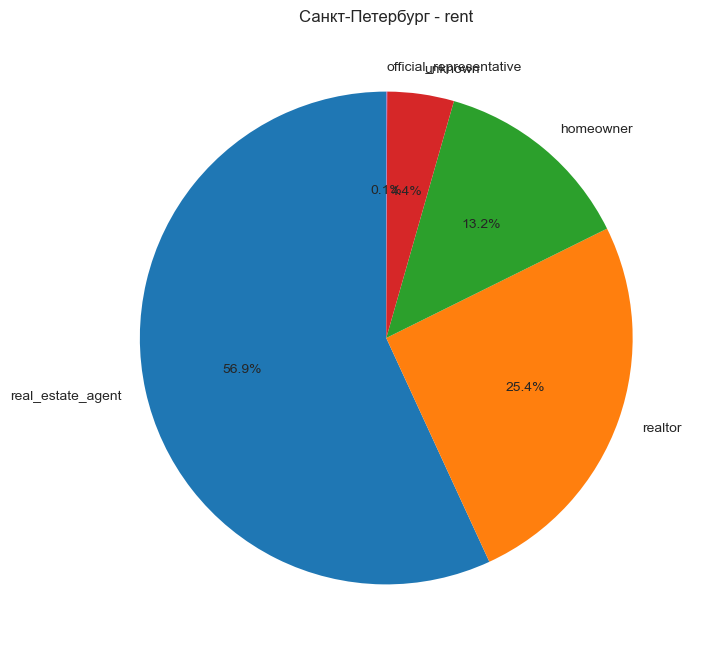

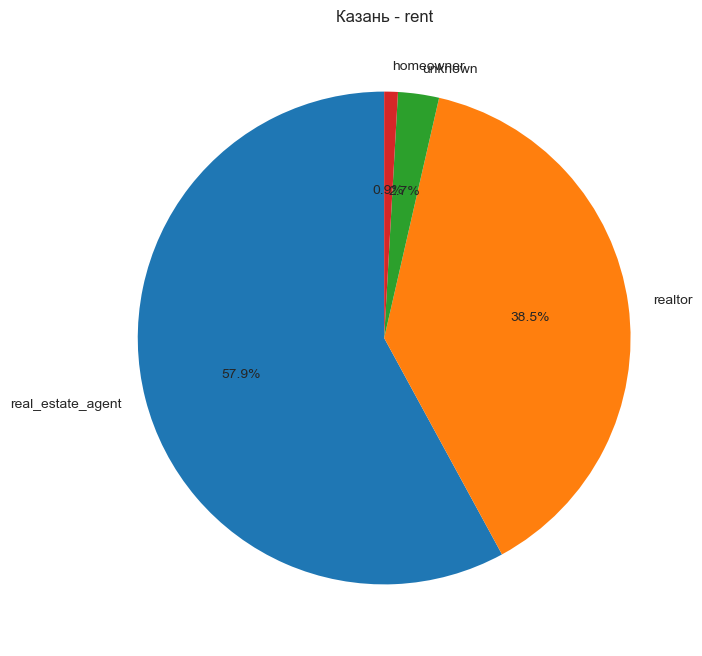

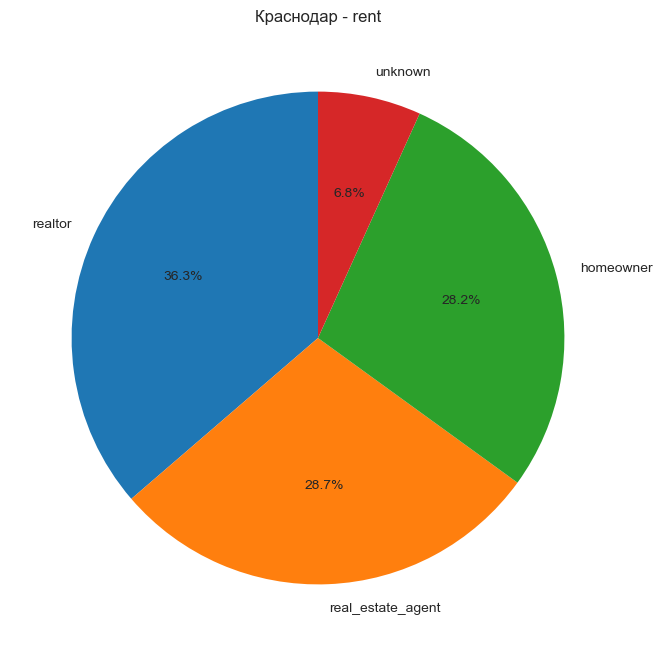

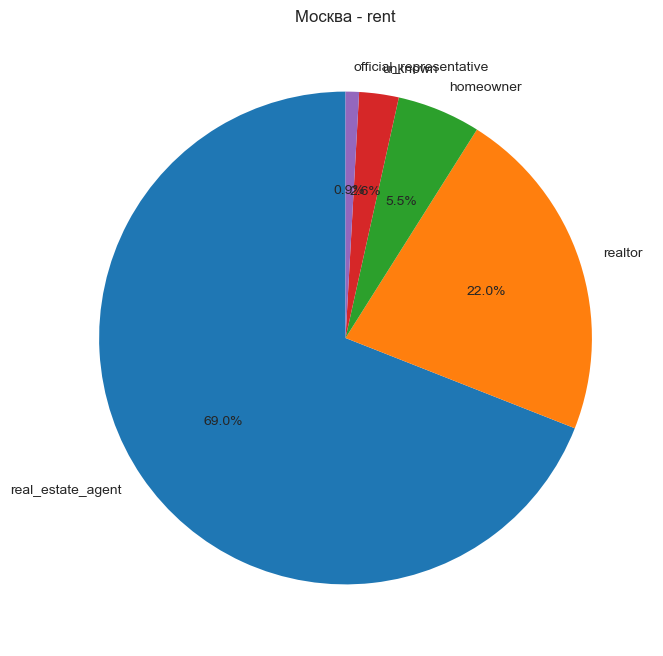

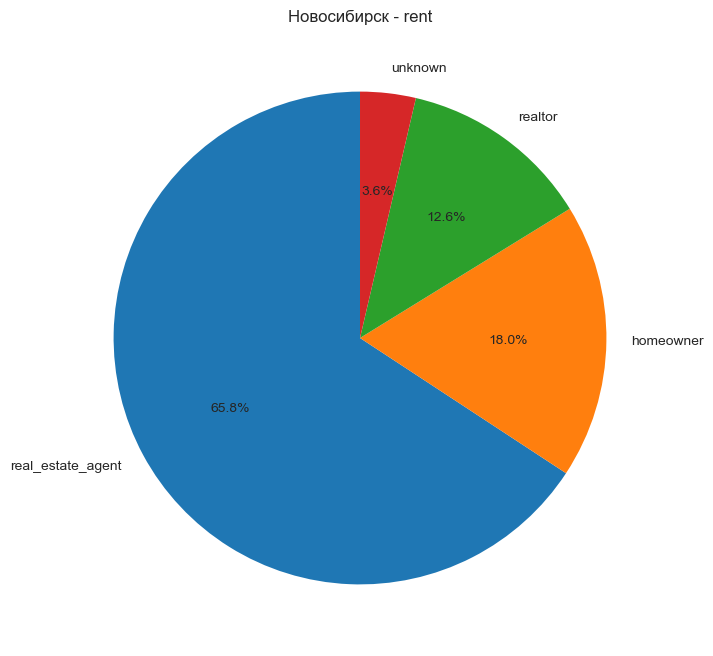

...

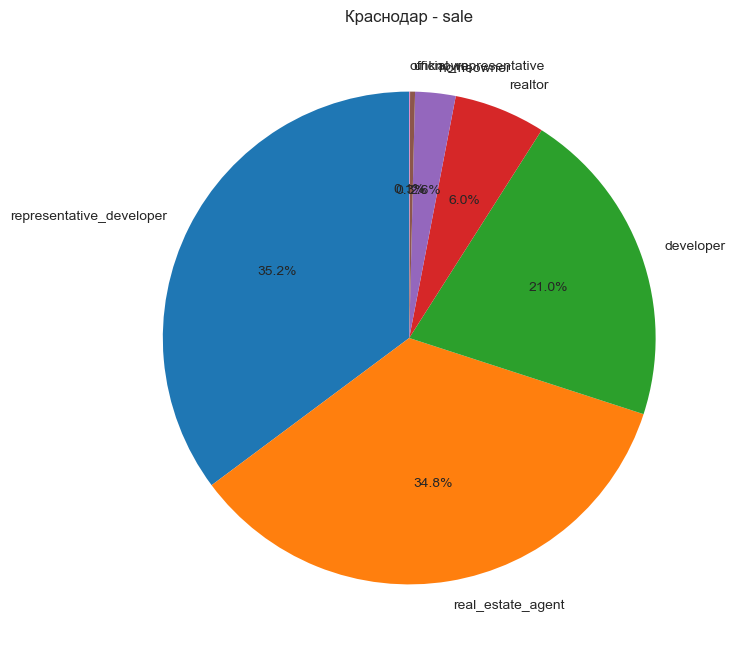

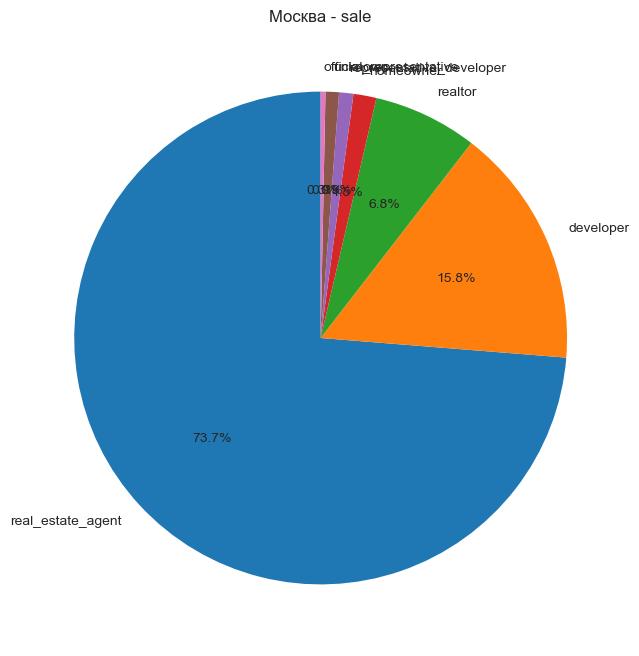

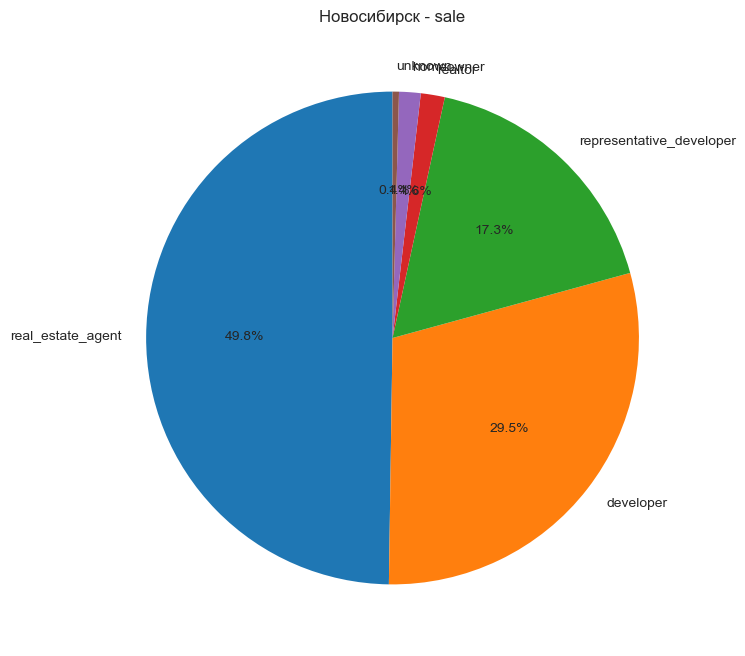

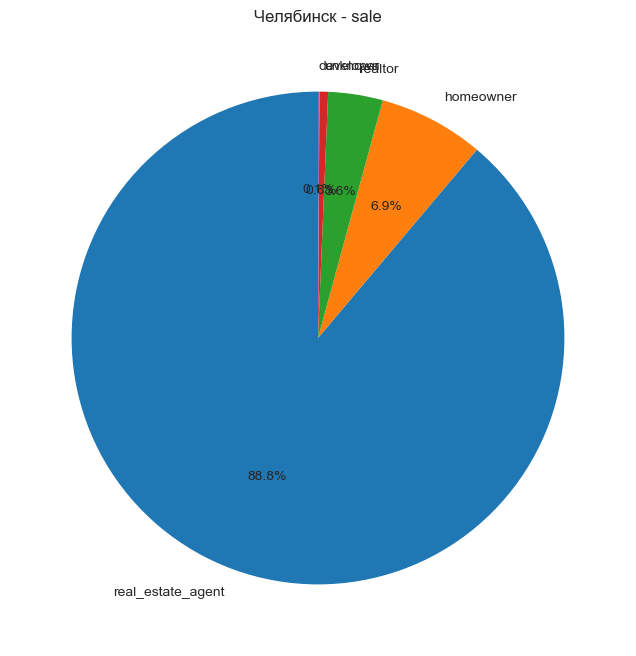

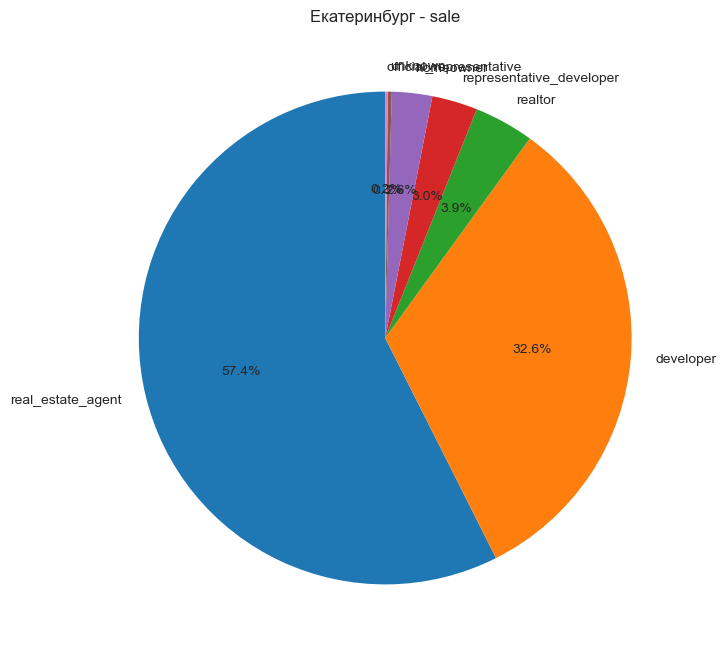

In [18]:
for t in deal_types:
    
    for city in cities:

        filtered_data = data.query(f'city == "{city}" and deal_type == "{t}"')
        type_counts = filtered_data['author_type'].value_counts()
        plt.figure(figsize=(8, 8))
        plt.pie(type_counts, labels=type_counts.index, autopct='%1.1f%%', startangle=90)
        plt.title(f'{city} - {t}')
        plt.show()
        

### Процент объявлении от района

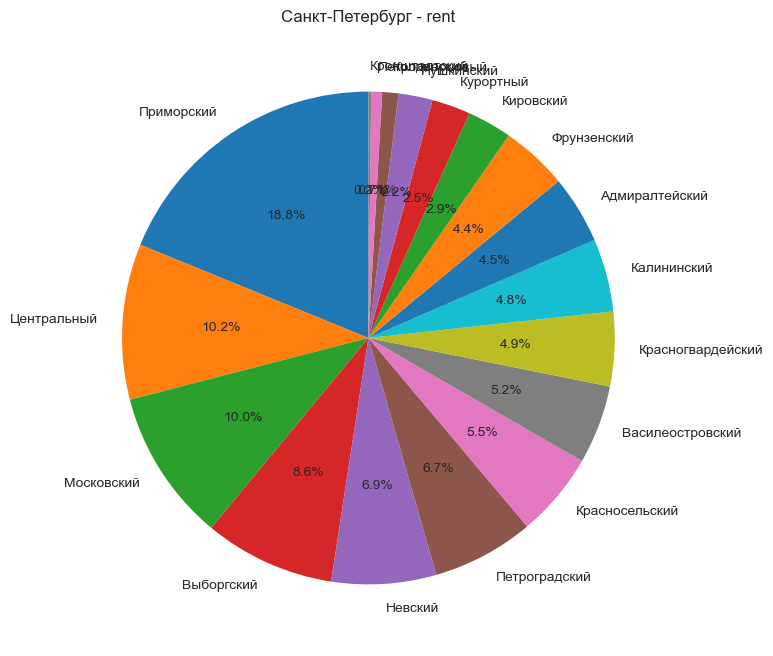

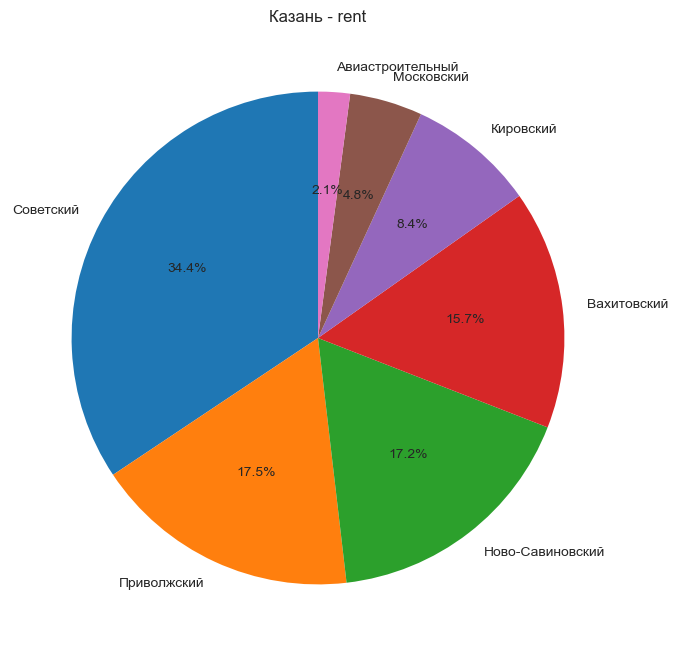

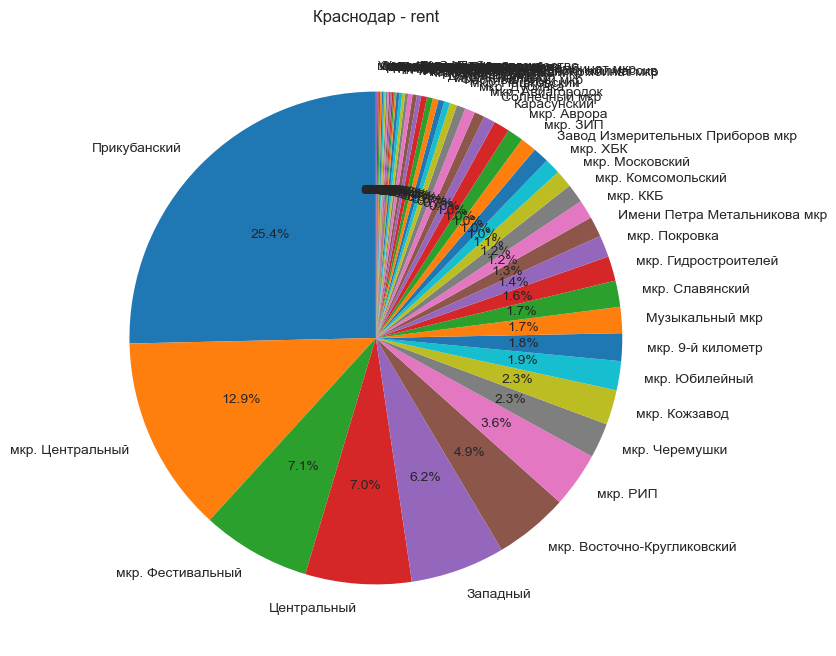

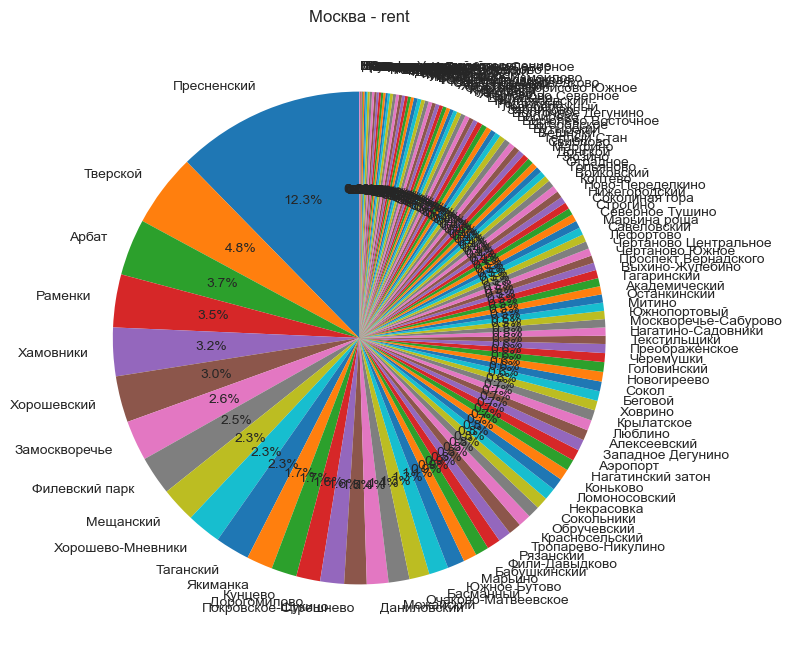

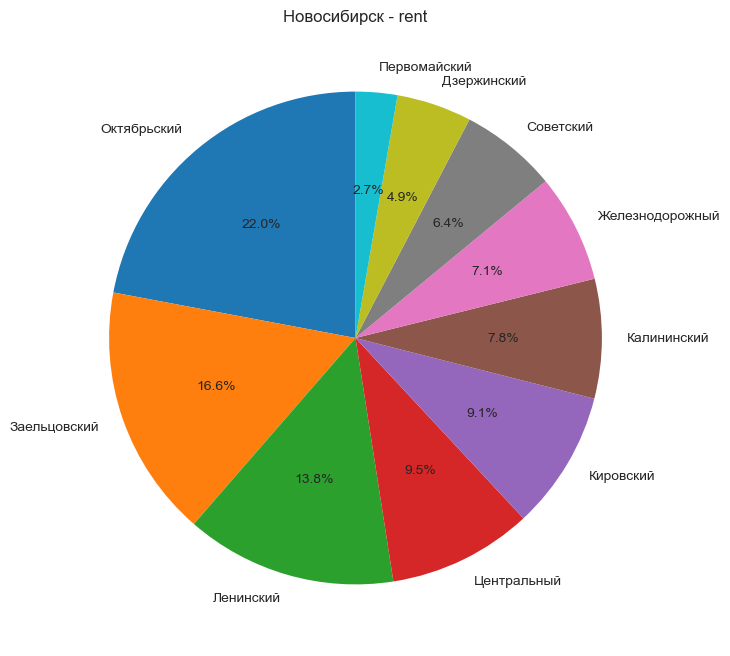

...

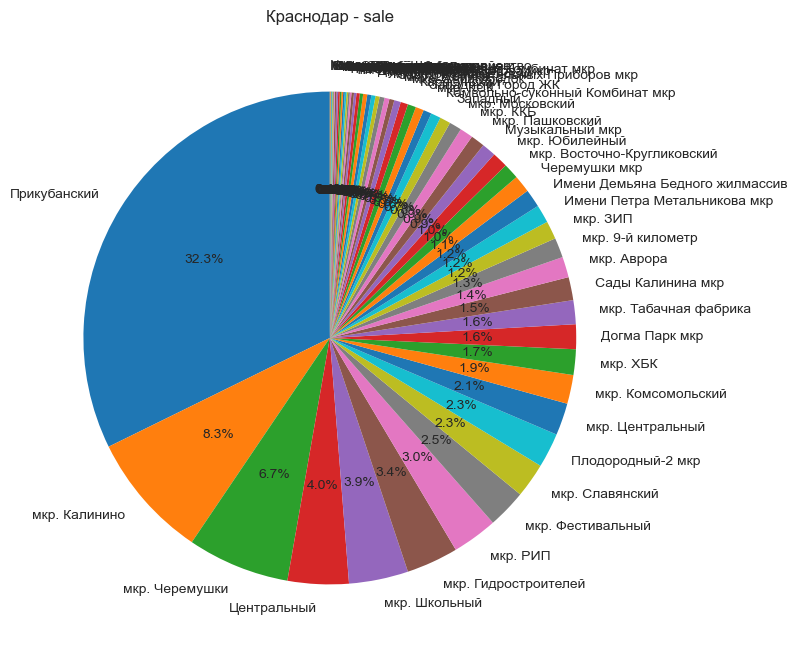

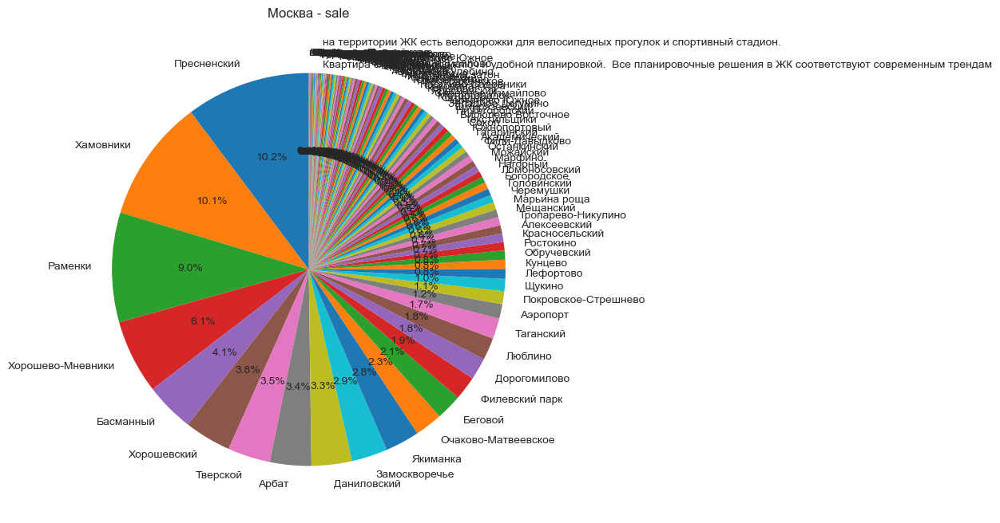

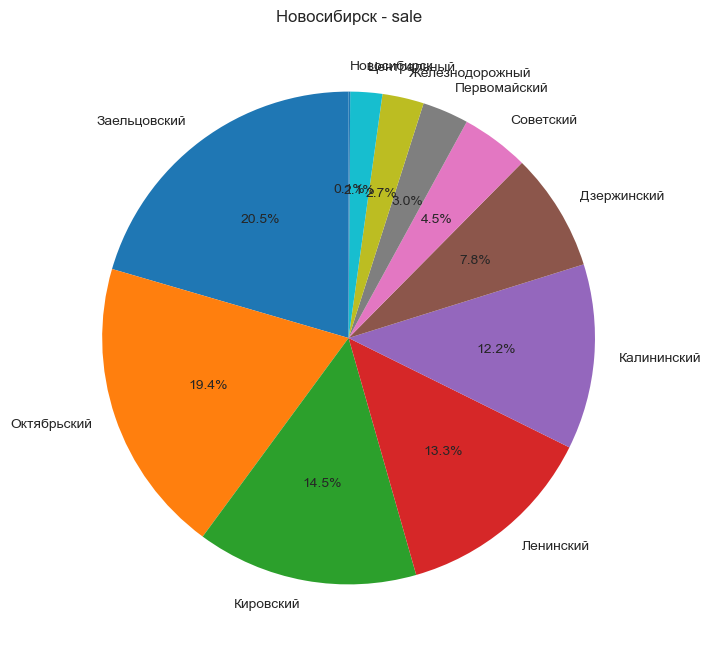

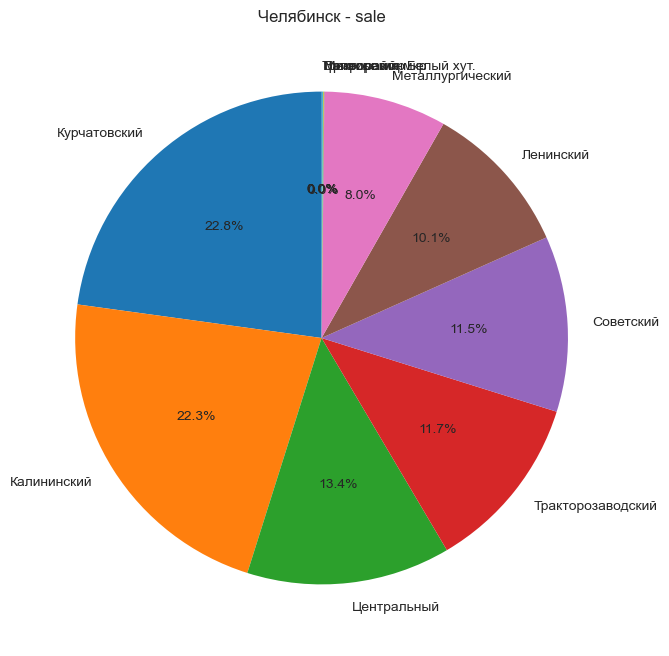

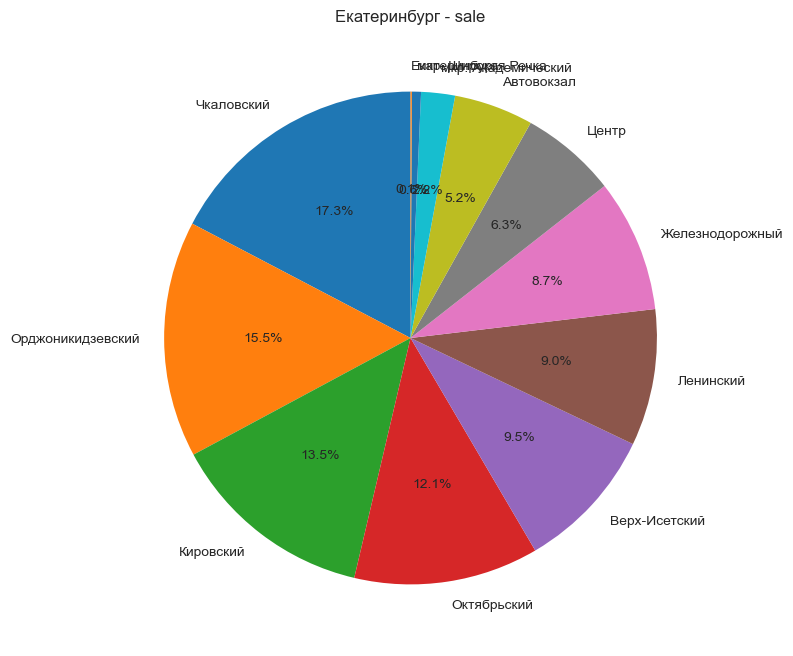

In [19]:
for t in deal_types:
    for city in cities:
        filtered_data = data.query(f'city == "{city}" and deal_type == "{t}"')
        type_counts = filtered_data['district'].value_counts()
        plt.figure(figsize=(8, 8))
        plt.pie(type_counts, labels=type_counts.index, autopct='%1.1f%%', startangle=90)
        plt.title(f'{city} - {t}')
        plt.show()

### Процент объявлении от города

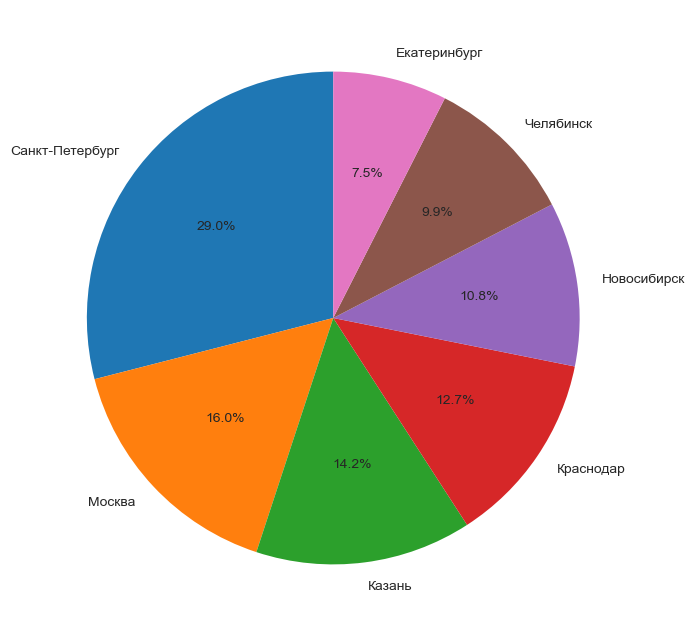

In [21]:
type_counts = data['city'].value_counts()

plt.figure(figsize=(8, 8))
plt.pie(type_counts, labels=type_counts.index, autopct='%1.1f%%', startangle=90)
plt.show()